<a href="https://colab.research.google.com/github/Tamrika/Deep-Learning/blob/main/Intel_Image_Classification_Challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hands on with CNN and Transfer Learning

## Intel Image Classification
This project deals with image data of Natural Scenes around the world.

Content:
Data contains around 25k images of size 150x150 distributed under 6 categories.
{'buildings' -> 0,
'forest' -> 1,
'glacier' -> 2,
'mountain' -> 3,
'sea' -> 4,
'street' -> 5 }

Objective is to build powerful Neural network that can classify these images with more accuracy.

In [ ]:
import zipfile, os
import shutil
import math
import numpy as np
import matplotlib.pyplot as plt


from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
import tensorflow.keras.utils 
import random


## Getting and Preparing Data 
Download the data and copy it to the directory structure that can be read by ImageDataGenerator.



In [ ]:
#Getting the Data
# downloading the files from dropbox
!wget --no-check-certificate  "https://uofi.box.com/shared/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip" -O intel.zip

#extrac the zip file downloaded
zip_ref = zipfile.ZipFile('intel.zip', 'r')
zip_ref.extractall()

--2021-03-31 05:52:29--  https://uofi.box.com/shared/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Resolving uofi.box.com (uofi.box.com)... 107.152.26.197
Connecting to uofi.box.com (uofi.box.com)|107.152.26.197|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip [following]
--2021-03-31 05:52:30--  https://uofi.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Reusing existing connection to uofi.box.com:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://uofi.app.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip [following]
--2021-03-31 05:52:30--  https://uofi.app.box.com/public/static/5tp2foxit52byt2zh9eqnnd8oi3ac9ym.zip
Resolving uofi.app.box.com (uofi.app.box.com)... 107.152.26.201
Connecting to uofi.app.box.com (uofi.app.box.com)|107.152.26.201|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://public.boxcl

## 1. Checking whether we have roughly same number of images in each category or if some categories are under or over-represented compared to others. 
Code to count the number of images in each category in train and test sets.

In [ ]:
base_dir = 'intel'
train_dir = os.path.join(base_dir, 'seg_train')
test_dir = os.path.join(base_dir, 'seg_test')

# for training images
for dir in os.listdir(train_dir):
  print('Total number of training images for the category', dir,':', len(os.listdir(os.path.join(train_dir, dir))))
print('\n')
# for testing images
for dir in os.listdir(os.path.join(test_dir)):
  print('Total number of test images for the category', dir,':', len(os.listdir(os.path.join(test_dir, dir))))


Total number of training images for the category sea : 2274
Total number of training images for the category forest : 2271
Total number of training images for the category mountain : 2512
Total number of training images for the category street : 2382
Total number of training images for the category buildings : 2191
Total number of training images for the category glacier : 2404


Total number of test images for the category sea : 510
Total number of test images for the category forest : 474
Total number of test images for the category mountain : 525
Total number of test images for the category street : 501
Total number of test images for the category buildings : 437
Total number of test images for the category glacier : 553


##2. Code to move 20% of the training data in each image category to a subdirectory under “seg_val” with the same name.  For example,  we move 20% of the building images in seg_train/building  to seg_val/building and so on.

Creating directory

In [ ]:
validation_dir = os.path.join(base_dir, 'seg_val')
os.mkdir(validation_dir)
  

Creating folders in validation directory and moving data to respective validation directory folders

In [ ]:
for dir in os.listdir(os.path.join(train_dir)):
  os.mkdir(os.path.join(validation_dir,dir))
  seg_val_cnt = math.ceil(len(os.listdir(os.path.join(train_dir, dir))) * 0.20)
  train_sub = os.listdir(os.path.join(train_dir, dir))
  for file in random.sample(train_sub, seg_val_cnt):
    shutil.move(os.path.join(train_dir, dir, file), os.path.join(validation_dir, dir, file))


In [ ]:
# for validation images
for dir in os.listdir(train_dir):
  print('Total number of validation images for the category', dir,':', len(os.listdir(os.path.join(validation_dir, dir))))

Total number of validation images for the category sea : 455
Total number of validation images for the category forest : 455
Total number of validation images for the category mountain : 503
Total number of validation images for the category street : 477
Total number of validation images for the category buildings : 439
Total number of validation images for the category glacier : 481


## 3. Creating image data generators for train and validation sets with class_mode=’categorical’ for a multiclass classification problem.

In [ ]:
# creating imageDataGenerator objects for train and validation data. rescale=1./255 normalizes images by dividing each pixel value by 255.
train_datagen = ImageDataGenerator(rescale=1./255)
val_datagen = ImageDataGenerator(rescale=1./255)


BATCH_SIZE=20


train_generator = train_datagen.flow_from_directory(
  #the directory to get the train data
  train_dir,
  #resize all images to 150*150
  target_size=(150, 150),
  #minibatch size 
  batch_size=BATCH_SIZE,
  #class_mode is 'binary 'for a binary classification problem (such as cat vs dogs example) or 'categorical' for a multiclass classificaiton problem
  class_mode='categorical')


validation_generator = val_datagen.flow_from_directory(
    #the directory to get the train data
    validation_dir,
    #resize all images to 150*150
    target_size=(150, 150),
    #minibatch size 
    batch_size=BATCH_SIZE,
    #this is a binary classification problem, so class_mode should be binary
    class_mode='categorical')


Found 11224 images belonging to 6 classes.
Found 2810 images belonging to 6 classes.


## 4. Creating a Baseline Convolutional Neural Network

In [ ]:
#Configuring the model architecture
def build_baseline():
  model=keras.Sequential(
    [
        # first convolution layer + max pooling layer  
        layers.Conv2D(32, (3, 3), activation='relu', padding="same",input_shape=(150, 150, 3)),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
                # second convolution layer + max pooling lyaer
        layers.Conv2D(64, (3, 3), padding="same", activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),

        # third convolution layer + max pooling lyaer
        layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        # fourth convolution layer + max pooling layer
        layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),

        #A global average pooling layer
        layers.GlobalAveragePooling2D(),
        

        # A Dense output layer with sigmoid activation   
        layers.Dense(6, activation='softmax')
    ])
  
# compliling model
  
  #create a learning_rate schedule
  lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-4,
    decay_steps=1000,
    decay_rate=0.9)

  #configuring and compiling the model
  opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
  model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

  #returning the model 
  return model

model=build_baseline()
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 150, 150, 32)      896       
_________________________________________________________________
batch_normalization (BatchNo (None, 150, 150, 32)      128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_1 (Batch (None, 75, 75, 64)        256       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 37, 37, 128)       7

### Model training

In [ ]:
#callback for early stopping
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, min_delta=1e-3, restore_best_weights=True)

#start the training
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 50,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
model.save("intel-baseline.h5")


Epoch 1/50
100/100 [==============================] - 38s 43ms/step - loss: 1.5421 - accuracy: 0.4021 - val_loss: 2.1288 - val_accuracy: 0.1510
Epoch 2/50
100/100 [==============================] - 4s 42ms/step - loss: 0.9367 - accuracy: 0.6464 - val_loss: 2.4729 - val_accuracy: 0.1840
Epoch 3/50
100/100 [==============================] - 4s 41ms/step - loss: 0.7986 - accuracy: 0.7077 - val_loss: 3.1862 - val_accuracy: 0.1870
Epoch 4/50
100/100 [==============================] - 4s 43ms/step - loss: 0.7672 - accuracy: 0.7249 - val_loss: 2.4698 - val_accuracy: 0.2530
Epoch 5/50
100/100 [==============================] - 4s 42ms/step - loss: 0.7426 - accuracy: 0.7462 - val_loss: 1.5475 - val_accuracy: 0.4340
Epoch 6/50
100/100 [==============================] - 4s 42ms/step - loss: 0.7039 - accuracy: 0.7574 - val_loss: 0.8158 - val_accuracy: 0.6670
Epoch 7/50
100/100 [==============================] - 5s 46ms/step - loss: 0.6330 - accuracy: 0.7628 - val_loss: 0.7657 - val_accuracy: 0.704

In [ ]:
def plot_model(history):
  #getting train and validation accuracies
  train_acc_CNN = history.history['accuracy']
  val_acc_CNN = history.history['val_accuracy']

  #getting train and validation losses
  train_loss_CNN = history.history['loss']
  val_loss_CNN = history.history['val_loss']
  epochs = range(1, len(train_loss_CNN) + 1)

  #plotting the training and validation accurracies
  plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
  plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
  plt.title('Training and validation accuracy for CNN')
  plt.legend()
  plt.figure()

  #plotting the train and validaiton losses
  plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
  plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
  plt.title('Training and validation loss for CNN')
  plt.legend()

  plt.show()

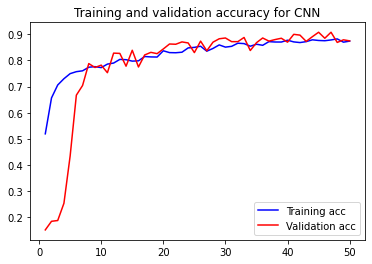

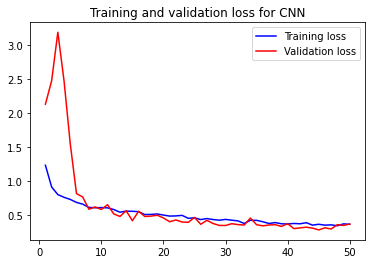

In [ ]:
plot_model(history)

**i. What can you understand from the learning curves? Does your model overfit?**
Though validation curves are not smooth, model does not overfit. We can observe that there is no significant difference between training and validation loss/accuracy. 



### Increasing the capacity of your model by adding one more convolutional layer

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 150, 150, 32)      896       
_________________________________________________________________
batch_normalization_4 (Batch (None, 150, 150, 32)      128       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_5 (Batch (None, 75, 75, 64)        256       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 37, 37, 128)      

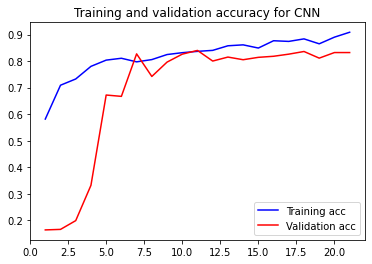

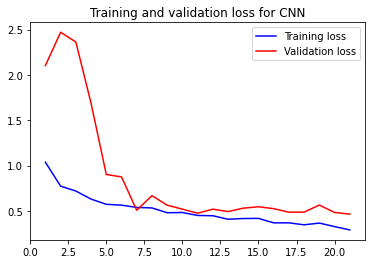

In [ ]:
#Tuning the model 
model=keras.Sequential(
[
  # first convolution layer + max pooling layer  
  layers.Conv2D(32, (3, 3), activation='relu', padding="same",input_shape=(150, 150, 3)),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
                # second convolution layer + max pooling lyaer
  layers.Conv2D(64, (3, 3), padding="same", activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),

  # third convolution layer + max pooling lyaer
  layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
  # fourth convolution layer + max pooling layer
  layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),

  # fifth convolution layer + max pooling layer
  layers.Conv2D(256, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
     
  #A global average pooling layer
  layers.GlobalAveragePooling2D(),
        
  # A Dense output layer with sigmoid activation   
  layers.Dense(6, activation='softmax')
])
  
# compliling model
  
#create a learning_rate schedule
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
initial_learning_rate=1e-4,
decay_steps=1000,
decay_rate=0.9)

#configuring and compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

print(model.summary())

#callback for early stopping
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, min_delta=1e-3, restore_best_weights=True)

#start the training
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 50,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
model.save("intel-model_with5Layers.h5")

plot_model(history)

**ii. How did adding more convolutional layers affected your training and validation accuracies?   Does the new model overfit?**
The above model is overfitting. Training loss is less than validation loss and traning accuracy is more than validation.
Lets add a couple of dense layers with relu activation+ drop out  at the top to see if it reduces overfitting or improves the validation accuracy of the model.

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_34 (Conv2D)           (None, 150, 150, 32)      896       
_________________________________________________________________
batch_normalization_34 (Batc (None, 150, 150, 32)      128       
_________________________________________________________________
max_pooling2d_34 (MaxPooling (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 75, 75, 64)        18496     
_________________________________________________________________
batch_normalization_35 (Batc (None, 75, 75, 64)        256       
_________________________________________________________________
max_pooling2d_35 (MaxPooling (None, 37, 37, 64)        0         
_________________________________________________________________
conv2d_36 (Conv2D)           (None, 37, 37, 128)      

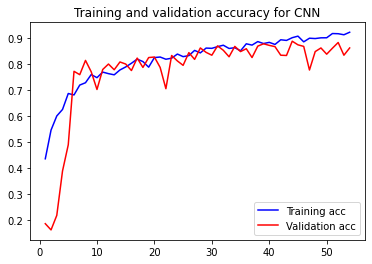

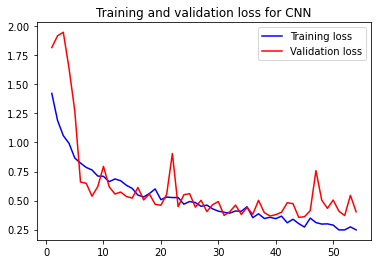

In [ ]:
#Tuning the model 
model=keras.Sequential(
[
  # first convolution layer + max pooling layer  
  layers.Conv2D(32, (3, 3), activation='relu', padding="same",input_shape=(150, 150, 3)),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
                # second convolution layer + max pooling lyaer
  layers.Conv2D(64, (3, 3), padding="same", activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),

  # third convolution layer + max pooling lyaer
  layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
  # fourth convolution layer + max pooling layer
  layers.Conv2D(128, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),

  # fifth convolution layer + max pooling layer
  layers.Conv2D(256, (3, 3), padding="same",activation='relu'),
  layers.BatchNormalization(),
  layers.MaxPooling2D((2, 2)),
     
  #A global average pooling layer
  layers.GlobalAveragePooling2D(),
   layers.Dense(256, activation='relu'), #DenseLayer1
  layers.Dropout(0.2), #Dropout1
  layers.Dense(128, activation='relu'), #DenseLayer1
  layers.Dropout(0.2), #Dropout1
  layers.Dense(64, activation='relu'),#DenseLayer2
  layers.Dropout(0.2), #Dropout2
  # A Dense output layer with softmax activation   
  layers.Dense(6, activation='softmax')
])
  
# compliling model
  
#create a learning_rate schedule
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
initial_learning_rate=1e-4,
decay_steps=1000,
decay_rate=0.9)

#configuring and compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

print(model.summary())

#callback for early stopping
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, min_delta=1e-3, restore_best_weights=True)

#start the training
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
model.save("intel-model_with5Layers.h5")

plot_model(history)

**iii. How did adding these dense layers at the top affect the train and validation accuracies?**
Adding more dense layers and drop outs slightly reduced overfitting. Loss is continuously decreasing inspite of increasing epochs to 100.


### Using data augmentation to improve the validation performance of baseline model

In [ ]:
#re-define the train_datagen with data augmentation
train_datagen = ImageDataGenerator(
rescale=1./255,
rotation_range=40,
width_shift_range=0.2,
height_shift_range=0.2,
shear_range=0.2,
zoom_range=0.2,
horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
  #the directory to get the train data
  train_dir,
  #resize all images to 150*150
  target_size=(150, 150),
  #minibatch size 
  batch_size=20,
  #class_mode is 'binary 'for a binary classification problem (such as cat vs dogs example) or 'categorical' for a multiclass classificaiton problem
  class_mode='categorical')

Found 11224 images belonging to 6 classes.


In [ ]:
model= build_baseline()

callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, min_delta=1e-3, restore_best_weights=True)
BATCH_SIZE=20
#start the training
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)

Epoch 1/100
100/100 [==============================] - 14s 131ms/step - loss: 1.5662 - accuracy: 0.4133 - val_loss: 1.9448 - val_accuracy: 0.1650
Epoch 2/100
100/100 [==============================] - 13s 129ms/step - loss: 1.0891 - accuracy: 0.5839 - val_loss: 2.1659 - val_accuracy: 0.2110
Epoch 3/100
100/100 [==============================] - 13s 130ms/step - loss: 1.0316 - accuracy: 0.5941 - val_loss: 2.2439 - val_accuracy: 0.2690
Epoch 4/100
100/100 [==============================] - 13s 128ms/step - loss: 1.0089 - accuracy: 0.6116 - val_loss: 1.7759 - val_accuracy: 0.3630
Epoch 5/100
100/100 [==============================] - 13s 129ms/step - loss: 0.9544 - accuracy: 0.6537 - val_loss: 1.2369 - val_accuracy: 0.5150
Epoch 6/100
100/100 [==============================] - 13s 128ms/step - loss: 0.9640 - accuracy: 0.6427 - val_loss: 0.9340 - val_accuracy: 0.6440
Epoch 7/100
100/100 [==============================] - 13s 130ms/step - loss: 0.8550 - accuracy: 0.6812 - val_loss: 0.8389 -

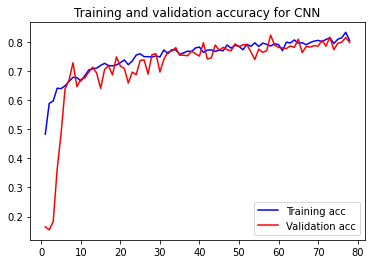

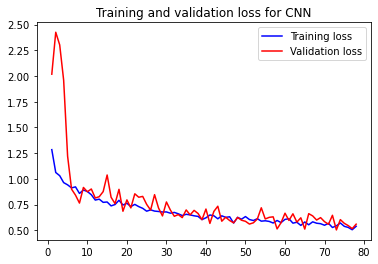

In [ ]:
plot_model(history)

**iv. Does data augmentationimprove the validation performance of your baseline model?**
After data augmentation, model is not overfitting.But accuracy still needs to be improved overall. 

## 5. Applying transfer learning with DenseNet121

In [ ]:
#instantiate a DenseNet121 model trained on ImageNet dataset
from tensorflow.keras.applications import DenseNet121
conv_base = DenseNet121(weights='imagenet',
include_top=False,
input_shape=(150, 150, 3))

#freeze the weight of the convolutional base
conv_base.trainable=False

# get the summary of the model to view its architecture
conv_base.summary()

29089792/29084464 [==============================] - 0s 0us/step
Model: "densenet121"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 150, 150, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 156, 156, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 75, 75, 64)   9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 75, 75, 64)   256         conv1/conv[0][0]                 
_______________________

In [ ]:

#initialize the topclassifier to the output of the convolutional base of densenet
topClassifier = conv_base.output

#Adding the global average pooling (GAP)layer on top of conv_base 
topClassifier=layers.GlobalAveragePooling2D()(topClassifier)

#adding a dense layer on top of GAP layer to do the classification
topClassifier = layers.Dense(6, activation="softmax")(topClassifier)

model = Model(inputs=conv_base.input, outputs=topClassifier)

model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 150, 150, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 156, 156, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 75, 75, 64)   9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 75, 75, 64)   256         conv1/conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
#create a learning_rate schedule
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-4,
    decay_steps=1000,
    decay_rate=0.9)

#configuring and compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

#callback for early stopping
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, min_delta=1e-3, restore_best_weights=True)

In [ ]:
#start the training
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)

Epoch 1/100
100/100 [==============================] - 18s 177ms/step - loss: 0.1776 - accuracy: 0.9330 - val_loss: 0.2173 - val_accuracy: 0.9200
Epoch 2/100
100/100 [==============================] - 18s 177ms/step - loss: 0.1628 - accuracy: 0.9400 - val_loss: 0.2849 - val_accuracy: 0.9100
Epoch 3/100
100/100 [==============================] - 18s 178ms/step - loss: 0.1526 - accuracy: 0.9465 - val_loss: 0.2304 - val_accuracy: 0.9320
Epoch 4/100
100/100 [==============================] - 18s 177ms/step - loss: 0.1715 - accuracy: 0.9355 - val_loss: 0.2595 - val_accuracy: 0.9180
Epoch 5/100
100/100 [==============================] - 18s 178ms/step - loss: 0.1499 - accuracy: 0.9485 - val_loss: 0.2639 - val_accuracy: 0.9210
Epoch 6/100
100/100 [==============================] - 18s 178ms/step - loss: 0.1720 - accuracy: 0.9350 - val_loss: 0.3156 - val_accuracy: 0.9020
Epoch 7/100
100/100 [==============================] - 18s 178ms/step - loss: 0.1407 - accuracy: 0.9455 - val_loss: 0.2747 -

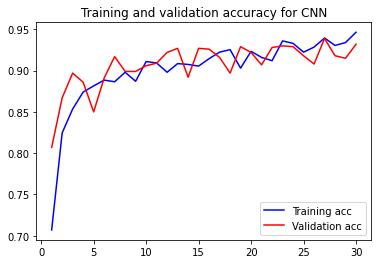

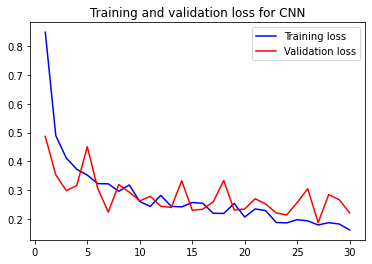

In [ ]:
plot_model(history)

**Does transfer learning increase your validation accuracy?**
Using transfer learning, we have reached a validation accuracy of about 92% which is much higher than other models we have built. Lets tune the model now.

### Model Tuning

In [ ]:
#unfreez the convolution base
conv_base.trainable = True

#set trainable to False for all layers except the last 9 , that is freeze the weights for all layers except the last 9 layers
for layer in conv_base.layers[:-9]:
    layer.trainable=False

#set trainable to True for the last 9 layers ( the last convolutional block in DENSENET121). That is unfreez the weights for the last 9 layers
for layer in conv_base.layers[-9:]:
    layer.trainable=True

Epoch 1/100
100/100 [==============================] - 20s 149ms/step - loss: 0.4564 - accuracy: 0.8388 - val_loss: 0.2737 - val_accuracy: 0.9060
Epoch 2/100
100/100 [==============================] - 13s 133ms/step - loss: 0.4220 - accuracy: 0.8507 - val_loss: 0.3179 - val_accuracy: 0.8820
Epoch 3/100
100/100 [==============================] - 13s 133ms/step - loss: 0.4887 - accuracy: 0.8366 - val_loss: 0.3038 - val_accuracy: 0.8930
Epoch 4/100
100/100 [==============================] - 13s 132ms/step - loss: 0.4320 - accuracy: 0.8605 - val_loss: 0.2903 - val_accuracy: 0.9000
Epoch 5/100
100/100 [==============================] - 13s 132ms/step - loss: 0.4650 - accuracy: 0.8221 - val_loss: 0.3003 - val_accuracy: 0.9020
Epoch 6/100
100/100 [==============================] - 13s 132ms/step - loss: 0.4478 - accuracy: 0.8318 - val_loss: 0.2763 - val_accuracy: 0.9130
Epoch 7/100
100/100 [==============================] - 13s 132ms/step - loss: 0.4095 - accuracy: 0.8645 - val_loss: 0.2856 -

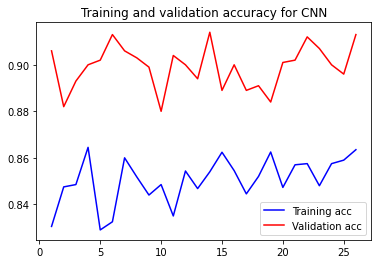

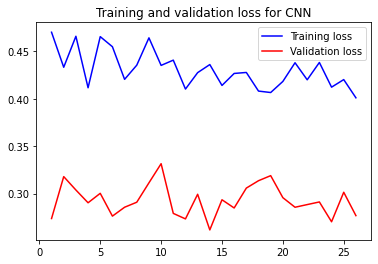

In [ ]:

opt = tf.keras.optimizers.Adam(learning_rate=1e-5)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, min_delta=1e-3, restore_best_weights=True)


model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

#Tune the model by fittig it for some more iterations to cat-vs-dog dataset
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
plot_model(history)

With learning_rate=lr_schedule

Epoch 1/100
40/40 [==============================] - 12s 172ms/step - loss: 0.2804 - accuracy: 0.8976 - val_loss: 0.2263 - val_accuracy: 0.9075
Epoch 2/100
40/40 [==============================] - 5s 134ms/step - loss: 0.3149 - accuracy: 0.9008 - val_loss: 0.2573 - val_accuracy: 0.9000
Epoch 3/100
40/40 [==============================] - 5s 134ms/step - loss: 0.3080 - accuracy: 0.8924 - val_loss: 0.2177 - val_accuracy: 0.9250
Epoch 4/100
40/40 [==============================] - 5s 132ms/step - loss: 0.3284 - accuracy: 0.8777 - val_loss: 0.2941 - val_accuracy: 0.8925
Epoch 5/100
40/40 [==============================] - 5s 133ms/step - loss: 0.3252 - accuracy: 0.8811 - val_loss: 0.2865 - val_accuracy: 0.9025
Epoch 6/100
40/40 [==============================] - 5s 132ms/step - loss: 0.2791 - accuracy: 0.9063 - val_loss: 0.2940 - val_accuracy: 0.9000
Epoch 7/100
40/40 [==============================] - 5s 133ms/step - loss: 0.3433 - accuracy: 0.8661 - val_loss: 0.2139 - val_accuracy: 0.932

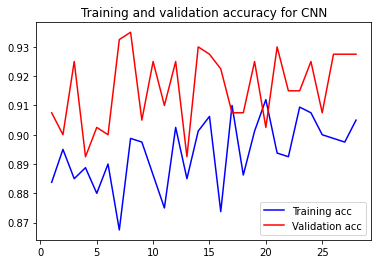

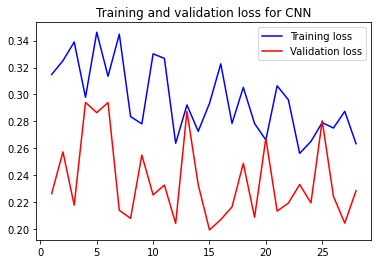

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-4,
    decay_steps=1000,
    decay_rate=0.9)

#configuring and compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, min_delta=1e-3, restore_best_weights=True)


model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

#Tune the model by fittig it for some more iterations to cat-vs-dog dataset
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
plot_model(history)

**Though validation accuracy of the above model did not improve significantly, it reduced overfitting of data.And, based on the below research, this model is considered as our final model.**

In [ ]:
#saving the final model
model.save("intel_finalModel.h5")

**Verified by adding additional dense layers and drop out which yielded no results. Changing batch size to 50 gave the same accuracy. **


Epoch 1/100
40/40 [==============================] - 12s 174ms/step - loss: 1.7022 - accuracy: 0.2916 - val_loss: 1.2595 - val_accuracy: 0.4850
Epoch 2/100
40/40 [==============================] - 5s 136ms/step - loss: 1.2156 - accuracy: 0.5492 - val_loss: 1.0129 - val_accuracy: 0.6325
Epoch 3/100
40/40 [==============================] - 5s 137ms/step - loss: 1.0788 - accuracy: 0.6338 - val_loss: 0.8303 - val_accuracy: 0.7325
Epoch 4/100
40/40 [==============================] - 5s 135ms/step - loss: 0.8117 - accuracy: 0.7373 - val_loss: 0.7260 - val_accuracy: 0.7575
Epoch 5/100
40/40 [==============================] - 5s 135ms/step - loss: 0.8363 - accuracy: 0.7058 - val_loss: 0.5716 - val_accuracy: 0.8250
Epoch 6/100
40/40 [==============================] - 5s 134ms/step - loss: 0.6754 - accuracy: 0.7951 - val_loss: 0.5040 - val_accuracy: 0.8550
Epoch 7/100
40/40 [==============================] - 5s 134ms/step - loss: 0.6646 - accuracy: 0.7871 - val_loss: 0.5515 - val_accuracy: 0.817

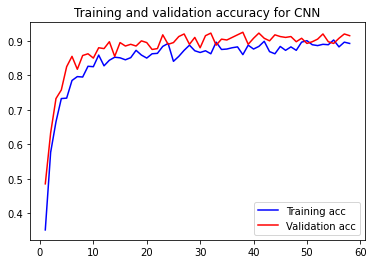

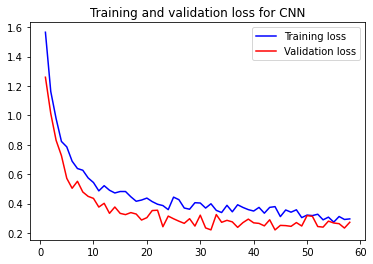

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-4,
    decay_steps=1000,
    decay_rate=0.9)
BATCH_SIZE=50
#configuring and compiling the model
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=20, min_delta=1e-3, restore_best_weights=True)


model.compile(loss="categorical_crossentropy", metrics=['accuracy'], optimizer=opt)

#Tune the model by fittig it for some more iterations to cat-vs-dog dataset
history = model.fit(
            train_generator,
            validation_data = validation_generator,
            steps_per_epoch = math.ceil(2000/BATCH_SIZE) ,
            epochs = 100,
            validation_steps = math.ceil(1000/BATCH_SIZE),
            callbacks=callback,
            verbose = 1)
plot_model(history)

## 6.Model Evaluation - Creating a test generator from images in seg_test

In [ ]:
#read the test images using ImageDataGenerator
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(150, 150),
    batch_size=20,
    shuffle=False ,
    class_mode='categorical')

#compute the loss and accurracy on the test set using model.evaluate method
test_loss, test_acc = model.evaluate(test_generator, steps=50)
print('test acc:', test_acc)

Found 3000 images belonging to 6 classes.
50/50 [==============================] - 2s 33ms/step - loss: 0.1321 - accuracy: 0.9530
test acc: 0.953000009059906


use  model.predict (<your test_generator>) to get the predicted probabilities for eachimage in the test data. The predicted probabilities will be an array of shape(number_of_test_images, 6) where 6 is the number of target classes (i.e., building,forest, etc....).  •

Use np.argmax(<your predicted probabilities>,axis=1)   to get the index of the classwith maximum predicted probability for each image. This returns an array of predictedclass indices for the images in the test data.

•You can also get the true class indices for the images in the test data by using  <yourtest generator>.classes•Now that you have both the predicted class indices and true class indices, you can get aconfusion matrix using confusion_matrix method from sklearn library.

•If you want to know which target category each index corresponds to, you can get amapping between class indices and the category they represent using <your testgenerator>.class_indices•Take a look at the confusion matrix, which categories your model seems to strugglewith the most? Visualize some of the misclassified images in those categories.

### model.predict(testgenerator) to get the predicted probabilities for eachimage in the test data.

In [ ]:
predictions = model.predict(test_generator)
predictions[0]

array([9.9967682e-01, 1.7465232e-05, 9.5714218e-05, 4.2180603e-05,
       8.0656973e-05, 8.7092129e-05], dtype=float32)

### np.argmax(,axis=1) to get the index of the classwith maximum predicted probability for each image.

In [ ]:
#np.argmax(,axis=1) to get the index of the classwith maximum predicted probability for each image
pred_labels = np.argmax(predictions, axis=1)
#true class indices
test_generator.classes



array([0, 0, 0, ..., 5, 5, 5], dtype=int32)

### Confusion Matrix

In [ ]:
from sklearn.metrics import confusion_matrix
cf_matrix = confusion_matrix(test_generator.classes, np.argmax(predictions, axis= 1), list(test_generator.class_indices.values()))
cf_matrix

array([[405,   1,   1,   0,   3,  27],
       [  0, 467,   3,   2,   1,   1],
       [  1,   3, 479,  44,  26,   0],
       [  1,   2,  66, 444,  12,   0],
       [  4,   3,   5,   7, 491,   0],
       [ 45,   0,   0,   0,   5, 451]])

### Heat map of Confusion matrix

[Text(0, 0.5, 'buildings'),
 Text(0, 1.5, 'forest'),
 Text(0, 2.5, 'glacier'),
 Text(0, 3.5, 'mountain'),
 Text(0, 4.5, 'sea'),
 Text(0, 5.5, 'street')]

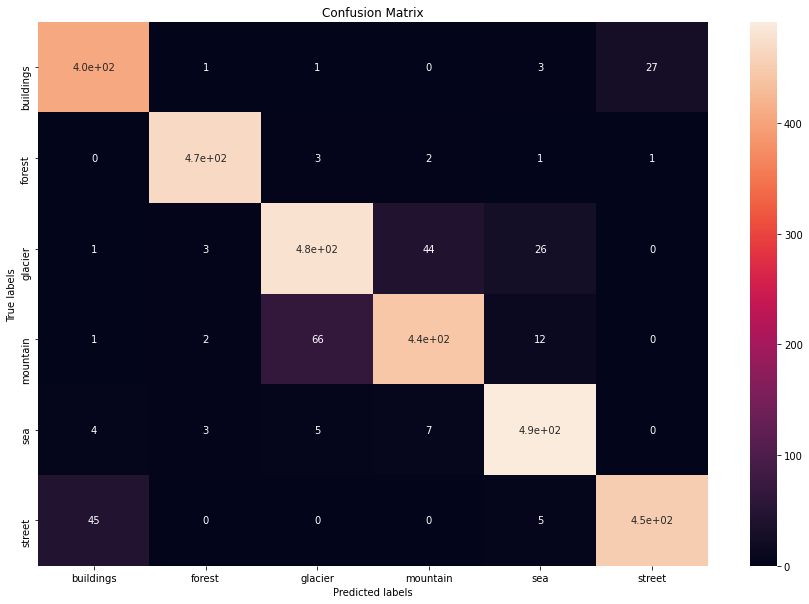

In [ ]:
import seaborn as sns
plt.subplots(figsize=(15,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax=ax)
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(list(test_generator.class_indices.keys())); ax.yaxis.set_ticklabels(list(test_generator.class_indices.keys()))

***which categories your model seems to strugglewith the most? ***

From the above matrix, we can say that most of the mountains are classified as glaciers, streets as buildings and vice versa.  

In [ ]:
test_generator.class_indices

{'buildings': 0,
 'forest': 1,
 'glacier': 2,
 'mountain': 3,
 'sea': 4,
 'street': 5}

### Misclassified images

True label is: 'buildings', CNN predicted 'sea' with confidences {'buildings': 0.1021, 'forest': 0.0007, 'glacier': 0.3099, 'mountain': 0.1284, 'sea': 0.3952, 'street': 0.0637}


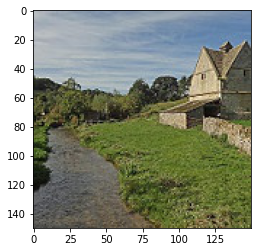

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.0872, 'forest': 0.0008, 'glacier': 0.0465, 'mountain': 0.0079, 'sea': 0.0261, 'street': 0.8317}


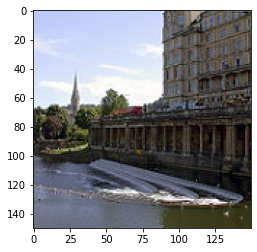

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4393, 'forest': 0.0031, 'glacier': 0.0065, 'mountain': 0.0094, 'sea': 0.0011, 'street': 0.5406}


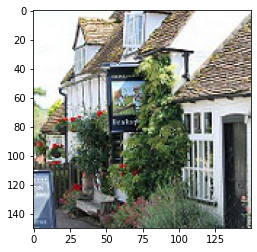

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4596, 'forest': 1e-04, 'glacier': 0.0023, 'mountain': 0.0011, 'sea': 0.0012, 'street': 0.5356}


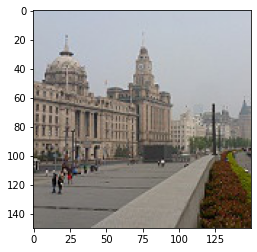

True label is: 'buildings', CNN predicted 'glacier' with confidences {'buildings': 0.2653, 'forest': 0.0176, 'glacier': 0.4408, 'mountain': 0.0631, 'sea': 0.1275, 'street': 0.0858}


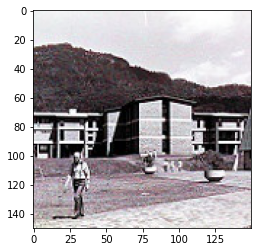

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3689, 'forest': 0.0013, 'glacier': 0.008, 'mountain': 0.0052, 'sea': 0.0048, 'street': 0.6117}


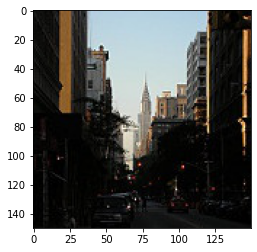

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.0016, 'forest': 0.0, 'glacier': 0.0003, 'mountain': 0.0011, 'sea': 1e-04, 'street': 0.9969}


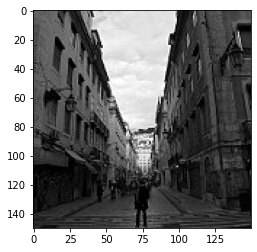

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3278, 'forest': 0.0003, 'glacier': 0.0016, 'mountain': 0.001, 'sea': 0.0005, 'street': 0.6689}


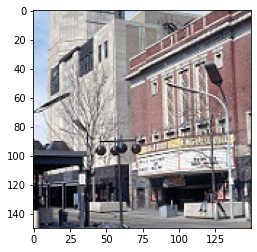

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.1646, 'forest': 0.0047, 'glacier': 0.0714, 'mountain': 0.0015, 'sea': 0.0239, 'street': 0.7338}


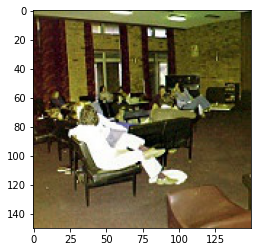

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4377, 'forest': 0.0053, 'glacier': 0.007, 'mountain': 0.0018, 'sea': 0.0037, 'street': 0.5445}


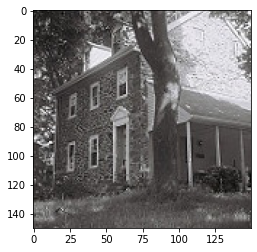

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.2122, 'forest': 0.0029, 'glacier': 0.0208, 'mountain': 0.0021, 'sea': 0.0031, 'street': 0.7589}


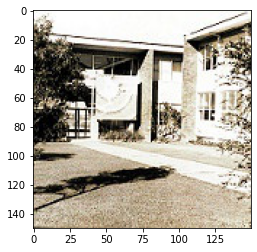

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.0322, 'forest': 0.0002, 'glacier': 0.0355, 'mountain': 0.0148, 'sea': 0.0118, 'street': 0.9055}


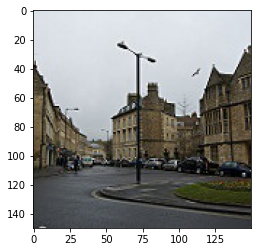

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.0671, 'forest': 0.0061, 'glacier': 0.0427, 'mountain': 0.0021, 'sea': 0.0204, 'street': 0.8616}


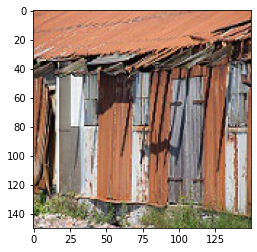

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3418, 'forest': 1e-04, 'glacier': 0.0028, 'mountain': 1e-04, 'sea': 0.0009, 'street': 0.6543}


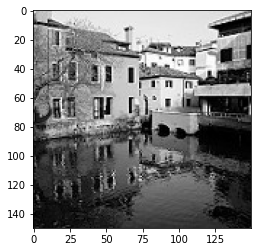

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.353, 'forest': 0.0003, 'glacier': 0.001, 'mountain': 0.0008, 'sea': 0.002, 'street': 0.643}


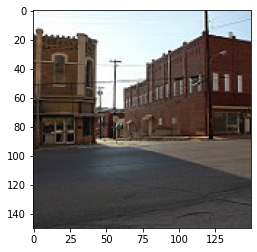

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3703, 'forest': 0.001, 'glacier': 0.0074, 'mountain': 0.0058, 'sea': 0.0039, 'street': 0.6117}


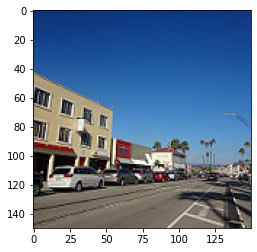

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4385, 'forest': 0.0098, 'glacier': 0.0157, 'mountain': 0.0197, 'sea': 0.0021, 'street': 0.5142}


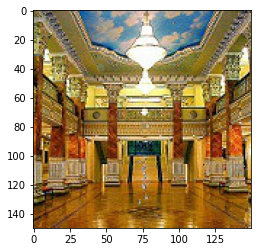

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.1201, 'forest': 1e-04, 'glacier': 0.0053, 'mountain': 0.0023, 'sea': 0.0012, 'street': 0.871}


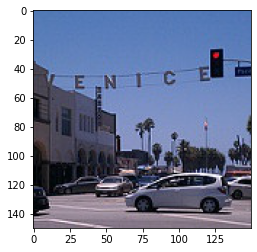

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4383, 'forest': 0.0005, 'glacier': 0.0012, 'mountain': 0.0004, 'sea': 0.0021, 'street': 0.5574}


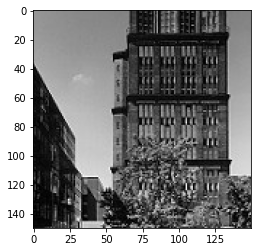

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.164, 'forest': 0.0002, 'glacier': 0.0068, 'mountain': 0.0005, 'sea': 0.0003, 'street': 0.8283}


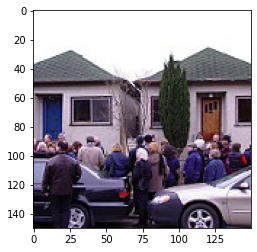

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.359, 'forest': 0.0043, 'glacier': 0.0183, 'mountain': 0.0224, 'sea': 0.0019, 'street': 0.5941}


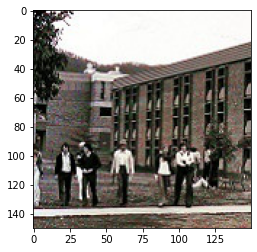

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4063, 'forest': 0.0012, 'glacier': 0.0018, 'mountain': 0.0053, 'sea': 0.0068, 'street': 0.5786}


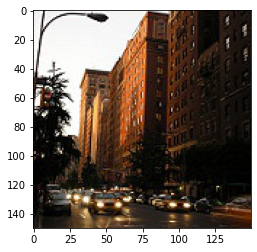

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.2064, 'forest': 0.001, 'glacier': 0.0017, 'mountain': 0.0069, 'sea': 0.0341, 'street': 0.7498}


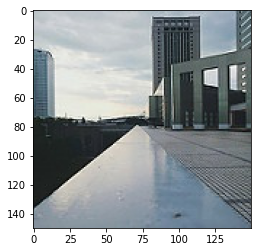

True label is: 'buildings', CNN predicted 'sea' with confidences {'buildings': 0.1367, 'forest': 0.1694, 'glacier': 0.1457, 'mountain': 0.0759, 'sea': 0.4453, 'street': 0.0269}


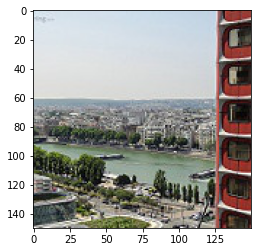

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.2019, 'forest': 0.0003, 'glacier': 0.0014, 'mountain': 0.0002, 'sea': 0.0005, 'street': 0.7957}


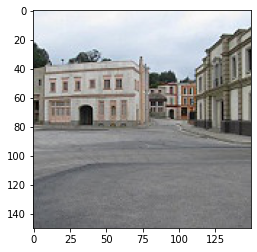

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3758, 'forest': 0.0017, 'glacier': 0.0042, 'mountain': 0.0122, 'sea': 0.0165, 'street': 0.5897}


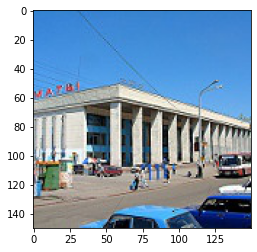

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3317, 'forest': 0.0007, 'glacier': 0.0014, 'mountain': 0.0002, 'sea': 0.0046, 'street': 0.6613}


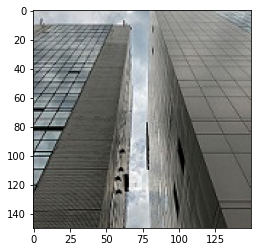

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.4394, 'forest': 0.0008, 'glacier': 0.0011, 'mountain': 0.0034, 'sea': 0.0005, 'street': 0.5547}


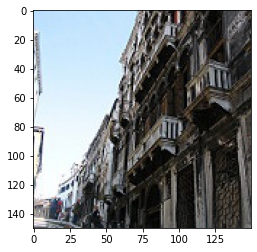

True label is: 'buildings', CNN predicted 'forest' with confidences {'buildings': 0.1124, 'forest': 0.6001, 'glacier': 0.0649, 'mountain': 0.0165, 'sea': 0.1882, 'street': 0.0179}


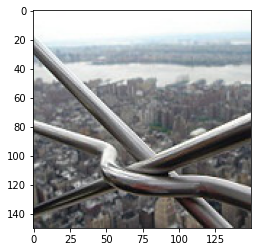

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.3162, 'forest': 0.0009, 'glacier': 0.0022, 'mountain': 0.0054, 'sea': 0.0039, 'street': 0.6714}


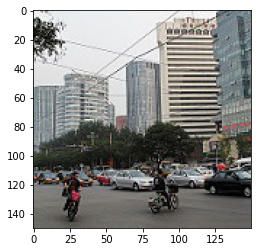

True label is: 'buildings', CNN predicted 'sea' with confidences {'buildings': 0.2584, 'forest': 0.1051, 'glacier': 0.0546, 'mountain': 0.0119, 'sea': 0.4002, 'street': 0.1699}


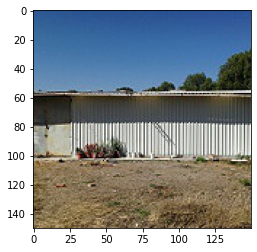

True label is: 'buildings', CNN predicted 'street' with confidences {'buildings': 0.0413, 'forest': 1e-04, 'glacier': 0.0002, 'mountain': 0.0, 'sea': 1e-04, 'street': 0.9582}


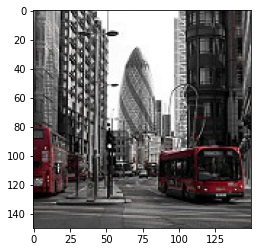

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0018, 'forest': 0.0008, 'glacier': 0.1192, 'mountain': 0.8654, 'sea': 0.0074, 'street': 0.0054}


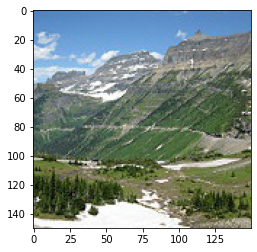

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0084, 'forest': 0.0008, 'glacier': 0.1405, 'mountain': 0.843, 'sea': 0.0054, 'street': 0.002}


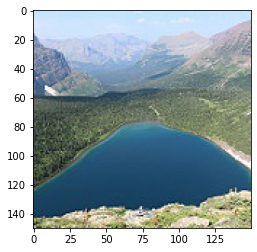

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0006, 'forest': 0.0005, 'glacier': 0.0715, 'mountain': 0.8869, 'sea': 0.0401, 'street': 0.0004}


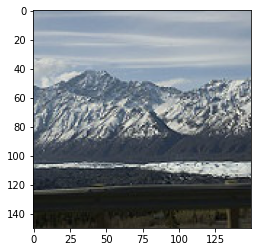

True label is: 'glacier', CNN predicted 'forest' with confidences {'buildings': 0.0009, 'forest': 0.6888, 'glacier': 0.028, 'mountain': 0.2652, 'sea': 0.0136, 'street': 0.0035}


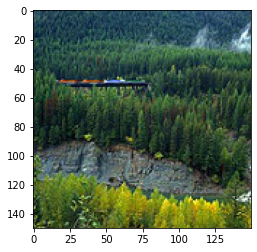

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0002, 'forest': 1e-04, 'glacier': 0.4617, 'mountain': 0.5376, 'sea': 0.0004, 'street': 1e-04}


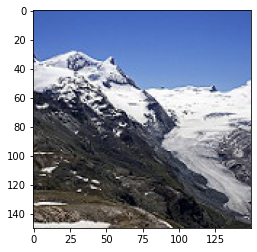

True label is: 'glacier', CNN predicted 'buildings' with confidences {'buildings': 0.9921, 'forest': 0.0, 'glacier': 0.0045, 'mountain': 0.0002, 'sea': 0.0008, 'street': 0.0024}


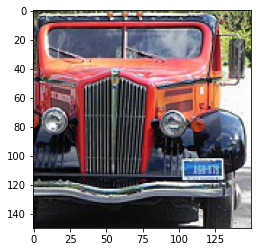

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0012, 'forest': 0.0003, 'glacier': 0.0154, 'mountain': 0.0015, 'sea': 0.9812, 'street': 0.0004}


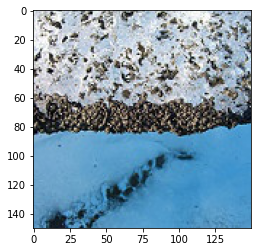

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0057, 'forest': 1e-04, 'glacier': 0.0499, 'mountain': 0.0422, 'sea': 0.902, 'street': 1e-04}


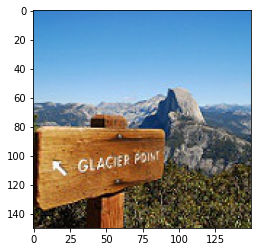

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0003, 'forest': 0.0007, 'glacier': 0.1636, 'mountain': 0.8329, 'sea': 0.0024, 'street': 1e-04}


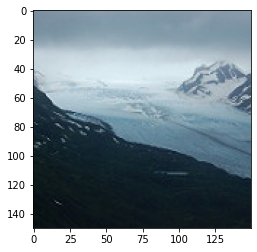

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.3143, 'mountain': 0.6851, 'sea': 0.0005, 'street': 0.0}


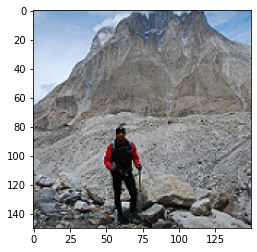

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0006, 'forest': 0.0049, 'glacier': 0.0558, 'mountain': 0.9299, 'sea': 0.0087, 'street': 0.0}


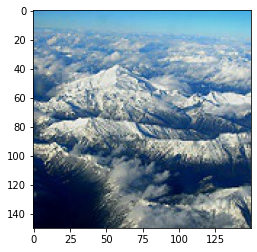

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0029, 'forest': 0.0008, 'glacier': 0.3481, 'mountain': 0.0968, 'sea': 0.5493, 'street': 0.0021}


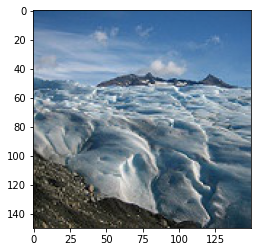

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0019, 'forest': 0.0003, 'glacier': 0.0166, 'mountain': 0.0262, 'sea': 0.9537, 'street': 0.0014}


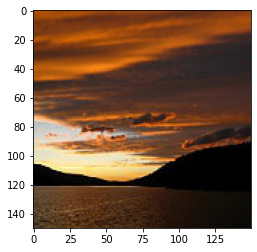

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0004, 'forest': 0.0003, 'glacier': 0.4003, 'mountain': 0.5983, 'sea': 0.0005, 'street': 0.0003}


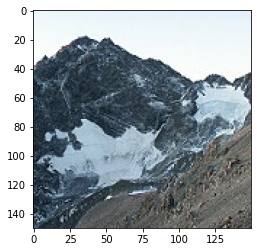

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0003, 'forest': 0.0003, 'glacier': 0.3625, 'mountain': 0.6353, 'sea': 0.0016, 'street': 0.0}


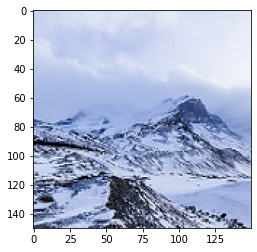

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0007, 'forest': 0.0005, 'glacier': 0.4132, 'mountain': 0.5833, 'sea': 0.0018, 'street': 0.0006}


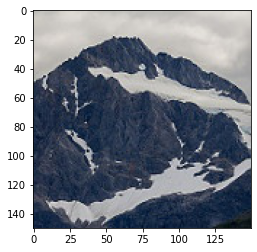

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0003, 'forest': 0.0, 'glacier': 0.3719, 'mountain': 0.6274, 'sea': 0.0003, 'street': 1e-04}


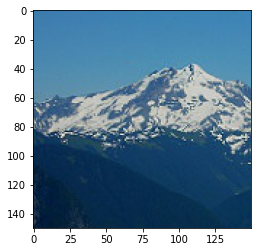

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0199, 'forest': 0.0049, 'glacier': 0.0094, 'mountain': 0.0061, 'sea': 0.9545, 'street': 0.0052}


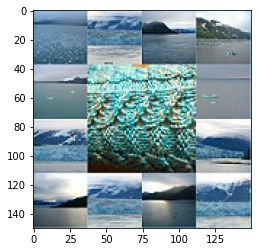

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0002, 'forest': 0.0002, 'glacier': 0.1036, 'mountain': 0.8952, 'sea': 0.0008, 'street': 1e-04}


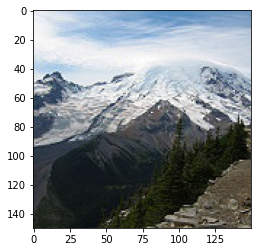

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.017, 'mountain': 0.9829, 'sea': 1e-04, 'street': 0.0}


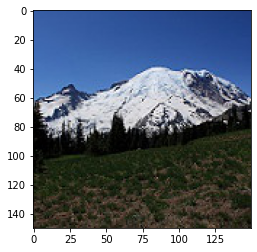

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0009, 'forest': 0.0, 'glacier': 0.0363, 'mountain': 0.0252, 'sea': 0.9371, 'street': 0.0004}


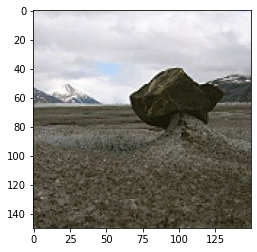

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0004, 'forest': 0.0096, 'glacier': 0.0484, 'mountain': 0.939, 'sea': 0.0021, 'street': 0.0005}


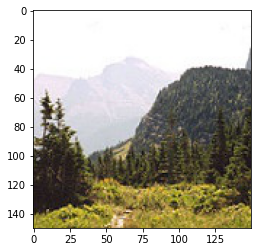

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0002, 'forest': 0.0, 'glacier': 0.3432, 'mountain': 0.6543, 'sea': 0.0021, 'street': 0.0002}


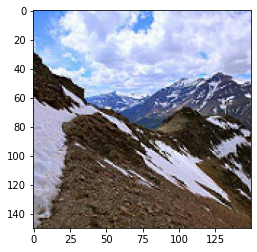

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0007, 'forest': 0.0002, 'glacier': 0.214, 'mountain': 0.0119, 'sea': 0.7727, 'street': 0.0005}


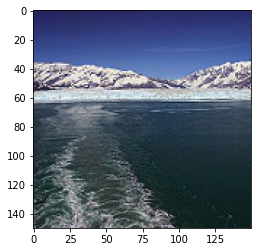

True label is: 'glacier', CNN predicted 'forest' with confidences {'buildings': 0.0027, 'forest': 0.7347, 'glacier': 0.0162, 'mountain': 0.1945, 'sea': 0.0069, 'street': 0.045}


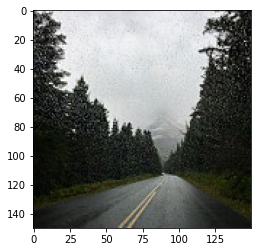

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0003, 'forest': 0.002, 'glacier': 0.2942, 'mountain': 0.6995, 'sea': 0.0029, 'street': 0.001}


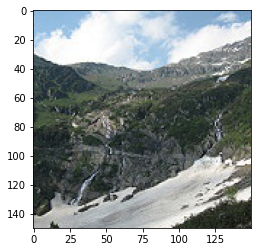

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0004, 'forest': 0.0003, 'glacier': 0.3872, 'mountain': 0.0017, 'sea': 0.6102, 'street': 0.0002}


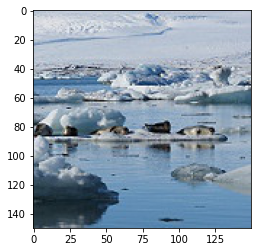

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0147, 'forest': 0.0025, 'glacier': 0.0603, 'mountain': 0.8387, 'sea': 0.0792, 'street': 0.0046}


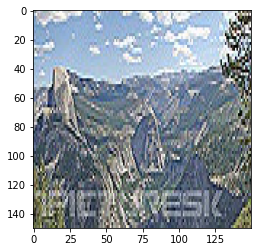

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 1e-04, 'forest': 1e-04, 'glacier': 0.1402, 'mountain': 0.8581, 'sea': 0.0015, 'street': 1e-04}


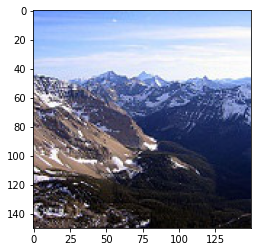

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0022, 'forest': 0.0087, 'glacier': 0.1803, 'mountain': 0.8043, 'sea': 0.0032, 'street': 0.0013}


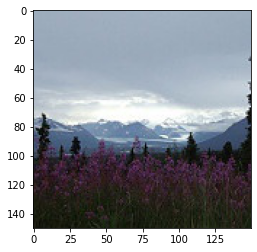

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0006, 'forest': 1e-04, 'glacier': 0.3451, 'mountain': 0.1789, 'sea': 0.475, 'street': 0.0003}


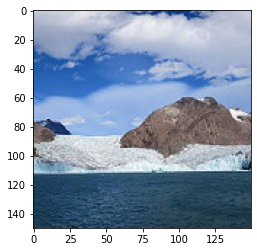

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0063, 'forest': 0.005, 'glacier': 0.1909, 'mountain': 0.1791, 'sea': 0.5028, 'street': 0.1159}


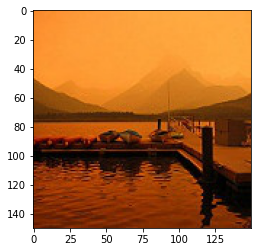

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0207, 'forest': 0.0045, 'glacier': 0.3627, 'mountain': 0.0316, 'sea': 0.5642, 'street': 0.0163}


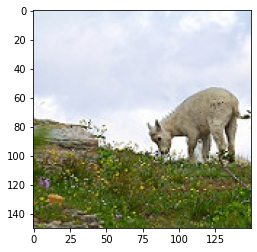

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.1053, 'mountain': 0.8943, 'sea': 0.0003, 'street': 0.0}


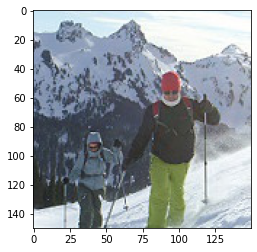

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0018, 'forest': 0.0002, 'glacier': 0.38, 'mountain': 0.6168, 'sea': 0.0011, 'street': 0.0002}


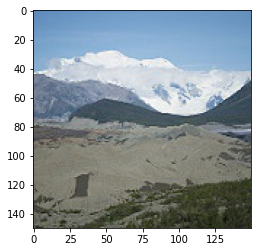

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0977, 'forest': 0.0958, 'glacier': 0.1012, 'mountain': 0.3074, 'sea': 0.339, 'street': 0.0589}


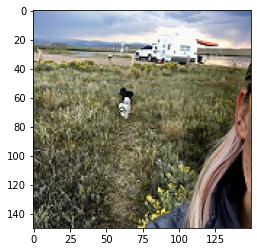

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 1e-04, 'forest': 0.0002, 'glacier': 0.044, 'mountain': 0.9553, 'sea': 0.0004, 'street': 1e-04}


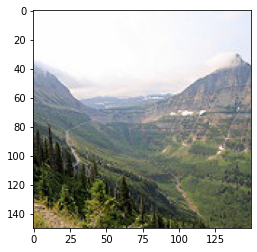

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 1e-04, 'forest': 0.0003, 'glacier': 0.1017, 'mountain': 0.0184, 'sea': 0.8775, 'street': 0.002}


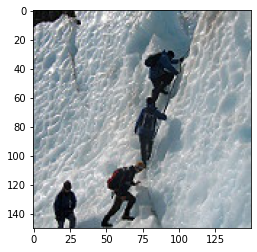

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0037, 'forest': 0.0082, 'glacier': 0.057, 'mountain': 0.0384, 'sea': 0.891, 'street': 0.0017}


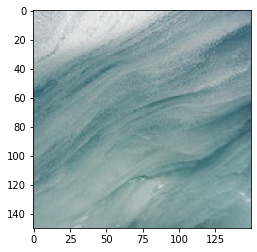

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0003, 'forest': 0.0003, 'glacier': 0.472, 'mountain': 0.5256, 'sea': 0.0017, 'street': 0.0002}


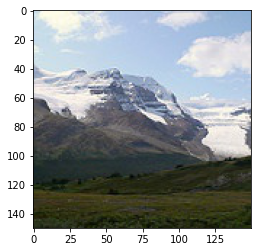

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0004, 'forest': 0.0155, 'glacier': 0.1277, 'mountain': 0.8525, 'sea': 0.0036, 'street': 0.0003}


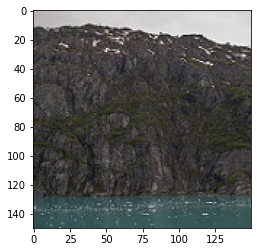

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0028, 'forest': 0.0027, 'glacier': 0.1115, 'mountain': 0.8628, 'sea': 0.0196, 'street': 0.0005}


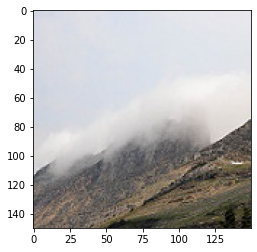

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0027, 'forest': 0.0, 'glacier': 0.0434, 'mountain': 0.008, 'sea': 0.9449, 'street': 0.001}


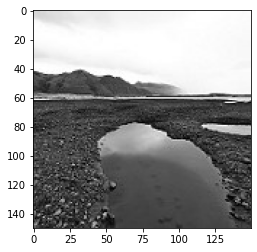

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0007, 'forest': 1e-04, 'glacier': 0.4933, 'mountain': 0.5039, 'sea': 0.001, 'street': 0.001}


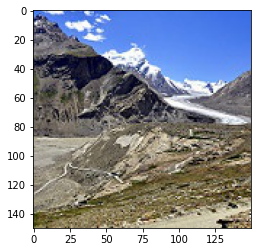

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 1e-04, 'forest': 0.0004, 'glacier': 0.0012, 'mountain': 0.0064, 'sea': 0.9916, 'street': 0.0003}


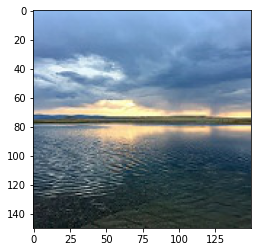

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 1e-04, 'forest': 0.0012, 'glacier': 0.4482, 'mountain': 0.5499, 'sea': 0.0005, 'street': 0.0}


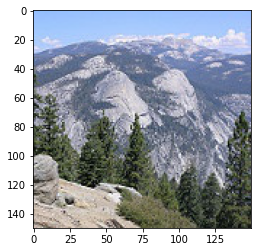

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0015, 'forest': 0.0016, 'glacier': 0.1753, 'mountain': 0.7918, 'sea': 0.0283, 'street': 0.0016}


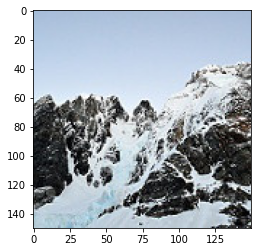

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 1e-04, 'forest': 0.0003, 'glacier': 0.0338, 'mountain': 0.9608, 'sea': 0.0049, 'street': 0.0002}


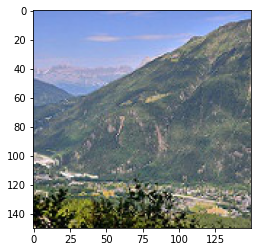

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0028, 'forest': 0.0015, 'glacier': 0.1098, 'mountain': 0.8718, 'sea': 0.0138, 'street': 0.0004}


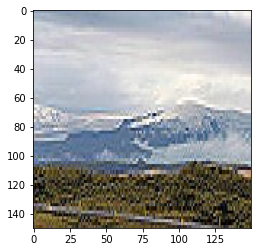

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.022, 'forest': 0.0003, 'glacier': 0.3049, 'mountain': 0.5044, 'sea': 0.0978, 'street': 0.0706}


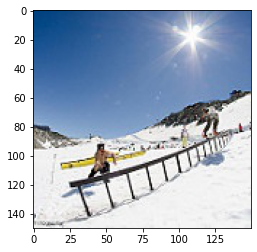

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0018, 'forest': 0.004, 'glacier': 0.055, 'mountain': 0.0084, 'sea': 0.928, 'street': 0.0028}


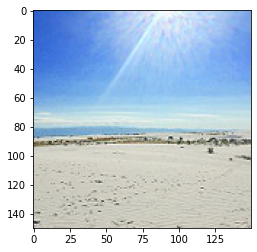

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0064, 'forest': 0.0232, 'glacier': 0.0591, 'mountain': 0.2898, 'sea': 0.6177, 'street': 0.0037}


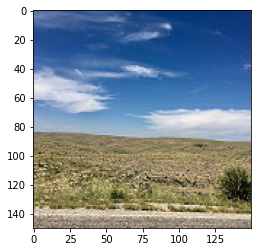

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.0216, 'mountain': 0.0043, 'sea': 0.9693, 'street': 0.0042}


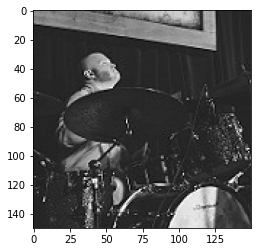

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0009, 'forest': 1e-04, 'glacier': 0.0595, 'mountain': 0.9308, 'sea': 0.008, 'street': 0.0006}


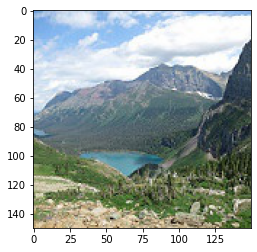

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.0211, 'mountain': 0.0002, 'sea': 0.9787, 'street': 0.0}


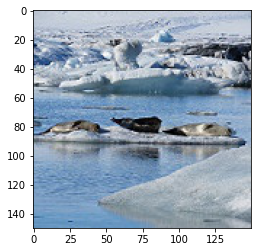

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0106, 'forest': 0.0025, 'glacier': 0.0338, 'mountain': 0.2194, 'sea': 0.7279, 'street': 0.0059}


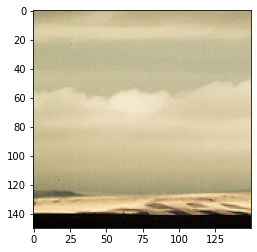

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0012, 'forest': 0.0002, 'glacier': 0.1986, 'mountain': 0.0201, 'sea': 0.7719, 'street': 0.008}


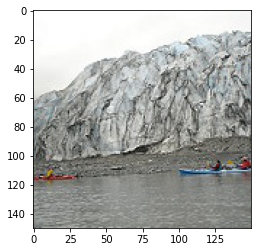

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0006, 'forest': 0.0006, 'glacier': 0.0449, 'mountain': 0.9518, 'sea': 0.0018, 'street': 0.0003}


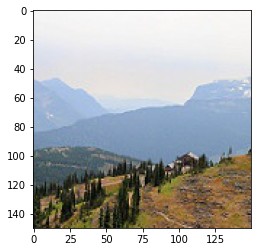

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0011, 'forest': 0.0072, 'glacier': 0.3295, 'mountain': 0.6413, 'sea': 0.018, 'street': 0.003}


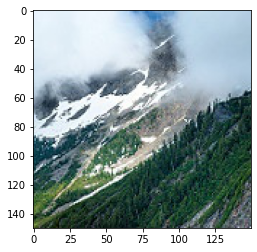

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0036, 'forest': 0.0044, 'glacier': 0.3771, 'mountain': 0.0582, 'sea': 0.5547, 'street': 0.002}


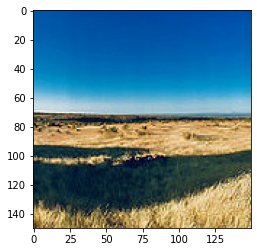

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0066, 'forest': 0.0012, 'glacier': 0.1227, 'mountain': 0.6862, 'sea': 0.1816, 'street': 0.0017}


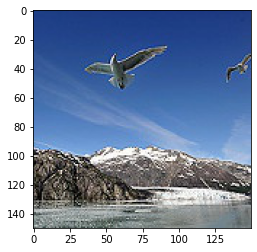

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0005, 'forest': 1e-04, 'glacier': 0.3999, 'mountain': 0.5982, 'sea': 0.0012, 'street': 1e-04}


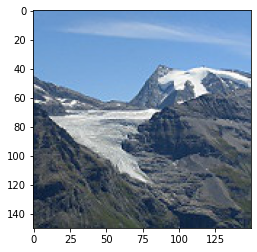

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 1e-04, 'forest': 1e-04, 'glacier': 0.0141, 'mountain': 0.9837, 'sea': 0.0019, 'street': 1e-04}


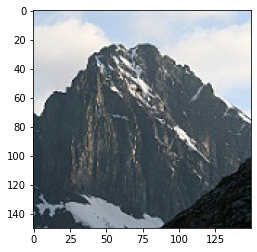

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.0004, 'forest': 0.0024, 'glacier': 0.3367, 'mountain': 0.0036, 'sea': 0.6563, 'street': 0.0005}


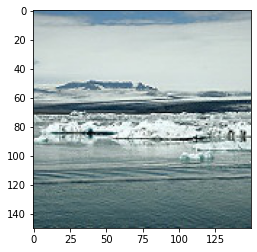

True label is: 'glacier', CNN predicted 'forest' with confidences {'buildings': 0.0007, 'forest': 0.9894, 'glacier': 0.008, 'mountain': 0.0012, 'sea': 0.0002, 'street': 0.0005}


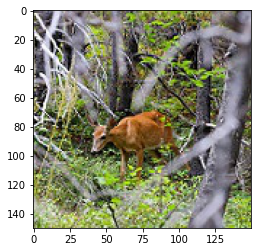

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 1e-04, 'forest': 1e-04, 'glacier': 0.4845, 'mountain': 0.0009, 'sea': 0.5143, 'street': 1e-04}


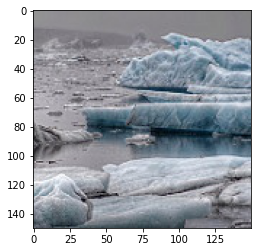

True label is: 'glacier', CNN predicted 'sea' with confidences {'buildings': 0.04, 'forest': 0.0417, 'glacier': 0.0307, 'mountain': 0.0879, 'sea': 0.7783, 'street': 0.0214}


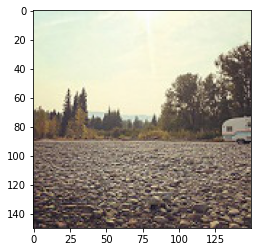

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0013, 'forest': 0.0, 'glacier': 0.0493, 'mountain': 0.9489, 'sea': 0.0004, 'street': 0.0}


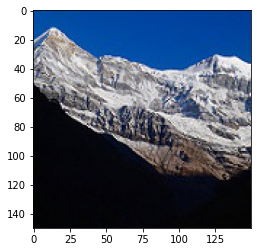

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0009, 'forest': 1e-04, 'glacier': 0.1928, 'mountain': 0.703, 'sea': 0.1022, 'street': 0.001}


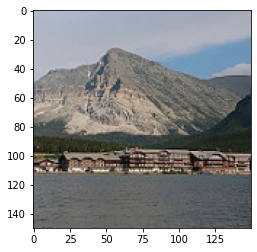

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0008, 'forest': 0.0058, 'glacier': 0.0424, 'mountain': 0.9493, 'sea': 0.0014, 'street': 0.0004}


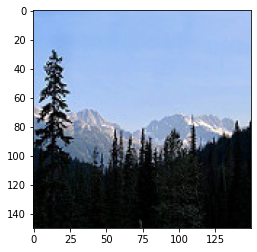

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0002, 'forest': 0.0034, 'glacier': 0.0211, 'mountain': 0.9723, 'sea': 0.0029, 'street': 1e-04}


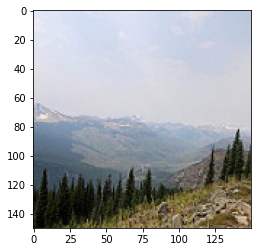

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0018, 'forest': 0.0039, 'glacier': 0.204, 'mountain': 0.7736, 'sea': 0.0166, 'street': 1e-04}


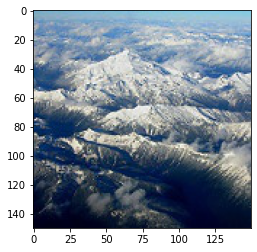

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0017, 'forest': 0.0017, 'glacier': 0.4162, 'mountain': 0.5704, 'sea': 0.0073, 'street': 0.0027}


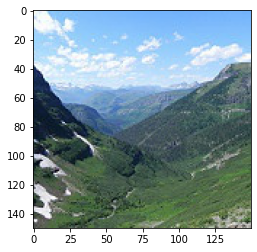

True label is: 'glacier', CNN predicted 'mountain' with confidences {'buildings': 0.0004, 'forest': 0.0014, 'glacier': 0.0197, 'mountain': 0.972, 'sea': 0.0062, 'street': 0.0002}


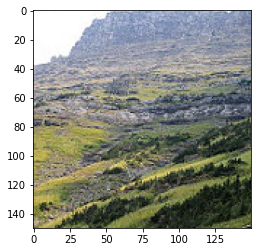

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.017, 'forest': 0.0208, 'glacier': 0.768, 'mountain': 0.1709, 'sea': 0.0118, 'street': 0.0113}


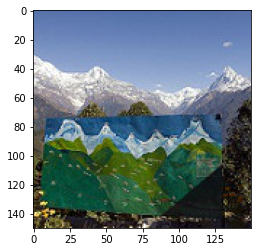

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0005, 'glacier': 0.5066, 'mountain': 0.4855, 'sea': 0.0071, 'street': 0.0}


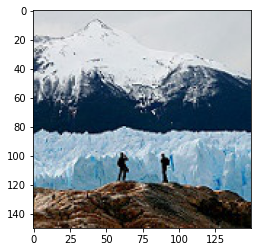

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0008, 'forest': 0.0006, 'glacier': 0.8006, 'mountain': 0.1914, 'sea': 0.0058, 'street': 0.0008}


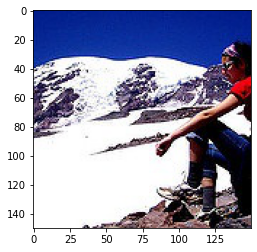

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0005, 'forest': 0.0004, 'glacier': 0.8383, 'mountain': 0.1451, 'sea': 0.0136, 'street': 0.002}


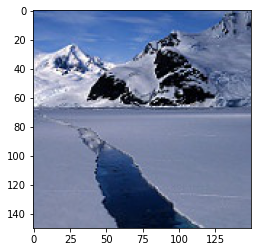

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0057, 'forest': 1e-04, 'glacier': 0.1627, 'mountain': 0.2776, 'sea': 0.5523, 'street': 0.0015}


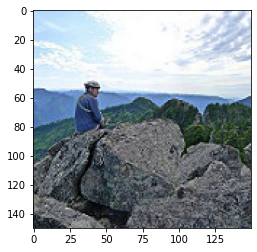

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0008, 'forest': 0.0015, 'glacier': 0.0644, 'mountain': 0.2826, 'sea': 0.65, 'street': 0.0006}


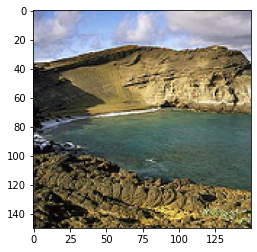

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0014, 'forest': 0.0005, 'glacier': 0.6831, 'mountain': 0.2859, 'sea': 0.0279, 'street': 0.0012}


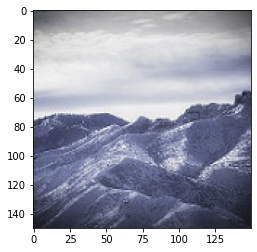

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.9069, 'mountain': 0.0925, 'sea': 0.0005, 'street': 0.0}


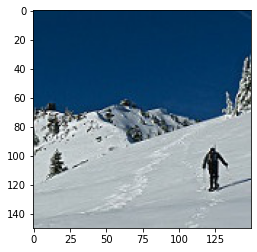

True label is: 'mountain', CNN predicted 'forest' with confidences {'buildings': 0.2709, 'forest': 0.4322, 'glacier': 0.0761, 'mountain': 0.0343, 'sea': 0.0499, 'street': 0.1365}


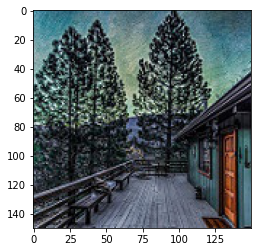

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0022, 'forest': 0.0031, 'glacier': 0.5214, 'mountain': 0.4619, 'sea': 0.0095, 'street': 0.0018}


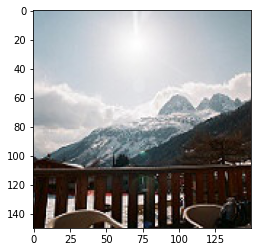

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0006, 'forest': 0.0024, 'glacier': 0.101, 'mountain': 0.3447, 'sea': 0.5399, 'street': 0.0113}


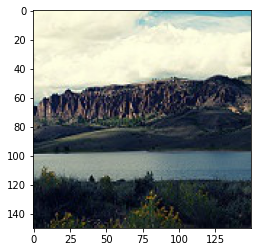

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.5775, 'mountain': 0.4169, 'sea': 0.0044, 'street': 0.0007}


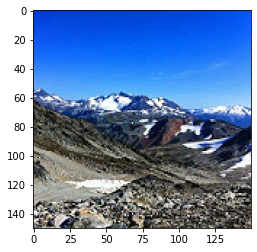

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0013, 'forest': 0.0012, 'glacier': 0.5764, 'mountain': 0.4155, 'sea': 0.0054, 'street': 1e-04}


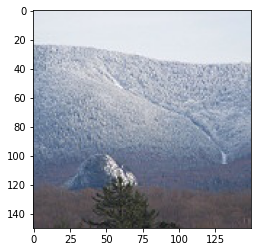

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0002, 'glacier': 0.9941, 'mountain': 0.005, 'sea': 0.0005, 'street': 0.0}


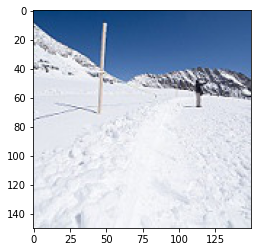

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 1e-04, 'glacier': 0.9055, 'mountain': 0.0932, 'sea': 0.0009, 'street': 0.0}


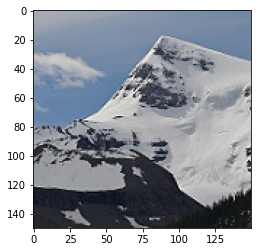

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0015, 'forest': 0.0016, 'glacier': 0.937, 'mountain': 0.0442, 'sea': 0.0151, 'street': 0.0006}


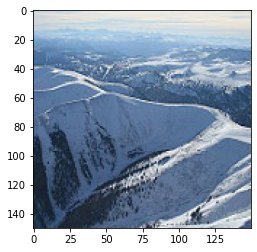

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.5717, 'mountain': 0.4253, 'sea': 0.0024, 'street': 1e-04}


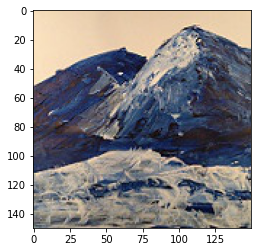

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0017, 'forest': 0.0013, 'glacier': 0.6383, 'mountain': 0.3007, 'sea': 0.0576, 'street': 0.0004}


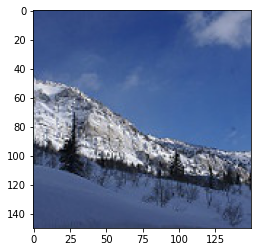

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 0.0002, 'glacier': 0.8748, 'mountain': 0.1212, 'sea': 0.0031, 'street': 0.0004}


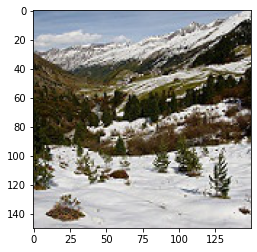

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.596, 'mountain': 0.4019, 'sea': 0.0013, 'street': 0.0002}


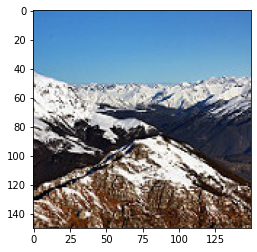

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0008, 'glacier': 0.5837, 'mountain': 0.4127, 'sea': 0.0022, 'street': 0.0004}


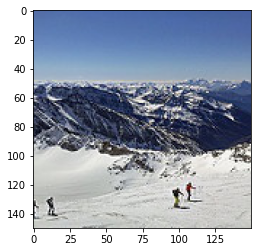

True label is: 'mountain', CNN predicted 'forest' with confidences {'buildings': 0.002, 'forest': 0.4388, 'glacier': 0.345, 'mountain': 0.1677, 'sea': 0.0332, 'street': 0.0132}


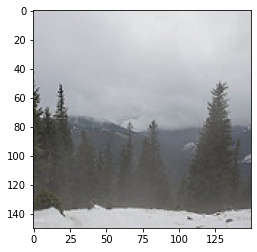

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0005, 'glacier': 0.8851, 'mountain': 0.111, 'sea': 0.0033, 'street': 1e-04}


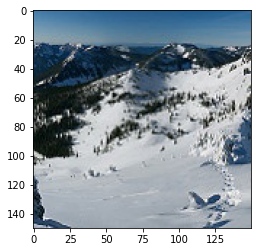

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 1e-04, 'glacier': 0.6053, 'mountain': 0.383, 'sea': 0.011, 'street': 0.0004}


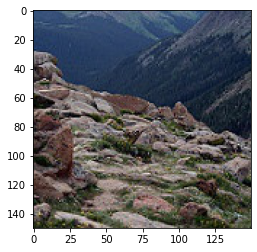

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0014, 'forest': 0.0007, 'glacier': 0.6292, 'mountain': 0.3519, 'sea': 0.0157, 'street': 0.0012}


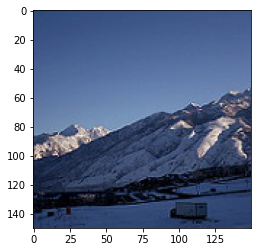

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0002, 'glacier': 0.9881, 'mountain': 0.0111, 'sea': 0.0004, 'street': 1e-04}


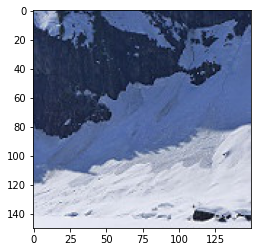

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0022, 'forest': 0.0002, 'glacier': 0.6114, 'mountain': 0.0923, 'sea': 0.2934, 'street': 0.0005}


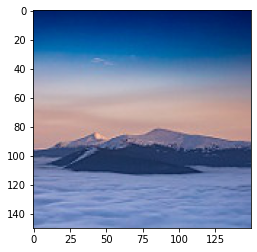

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0022, 'forest': 0.0, 'glacier': 0.8827, 'mountain': 0.1146, 'sea': 0.0004, 'street': 1e-04}


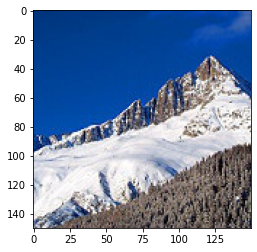

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.8684, 'mountain': 0.07, 'sea': 0.061, 'street': 1e-04}


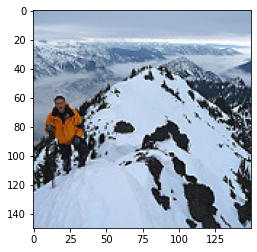

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.9609, 'mountain': 0.0382, 'sea': 0.0007, 'street': 1e-04}


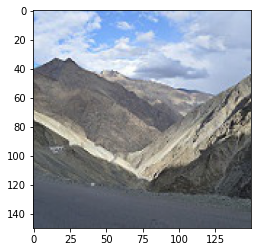

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.9685, 'mountain': 0.0302, 'sea': 0.0011, 'street': 1e-04}


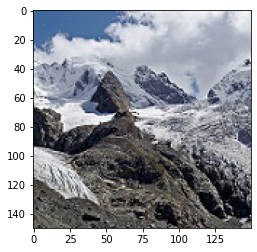

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0014, 'forest': 0.0004, 'glacier': 0.4976, 'mountain': 0.4937, 'sea': 0.0038, 'street': 0.0032}


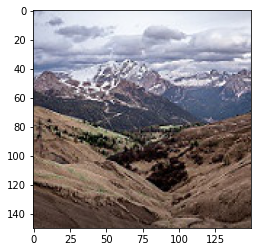

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.8804, 'mountain': 0.1194, 'sea': 0.0, 'street': 0.0}


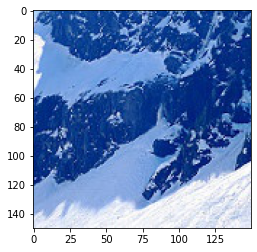

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0063, 'forest': 0.0053, 'glacier': 0.4603, 'mountain': 0.383, 'sea': 0.1396, 'street': 0.0055}


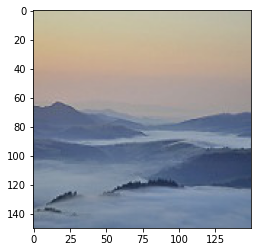

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0002, 'glacier': 0.8043, 'mountain': 0.1911, 'sea': 0.0035, 'street': 0.0006}


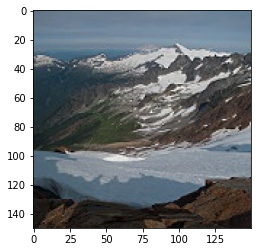

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0177, 'forest': 0.002, 'glacier': 0.0532, 'mountain': 0.3083, 'sea': 0.5959, 'street': 0.0228}


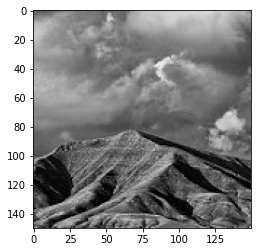

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.1772, 'forest': 0.0019, 'glacier': 0.3112, 'mountain': 0.0302, 'sea': 0.3885, 'street': 0.0909}


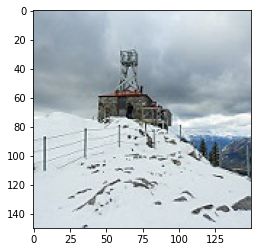

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.001, 'forest': 0.0052, 'glacier': 0.1203, 'mountain': 0.0294, 'sea': 0.8386, 'street': 0.0055}


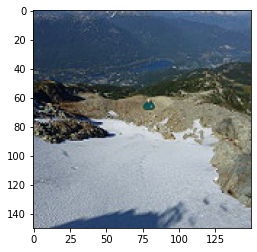

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0009, 'forest': 0.0002, 'glacier': 0.6694, 'mountain': 0.3225, 'sea': 0.0067, 'street': 0.0003}


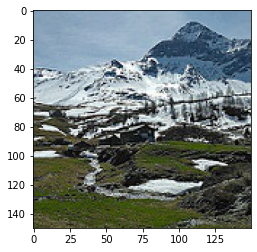

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0002, 'glacier': 0.9496, 'mountain': 0.0488, 'sea': 0.0012, 'street': 1e-04}


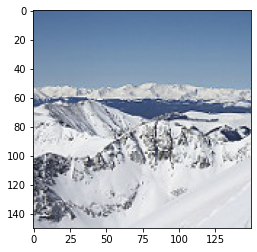

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 0.0003, 'glacier': 0.9084, 'mountain': 0.0809, 'sea': 0.0056, 'street': 0.0045}


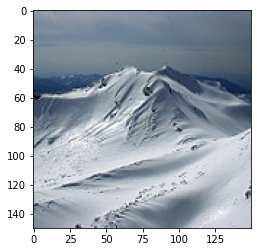

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0035, 'forest': 0.0128, 'glacier': 0.0044, 'mountain': 0.2663, 'sea': 0.7114, 'street': 0.0016}


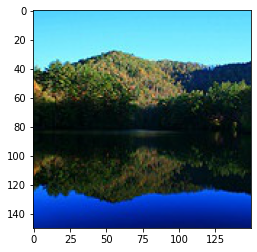

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0002, 'glacier': 0.7772, 'mountain': 0.2208, 'sea': 0.0014, 'street': 0.0003}


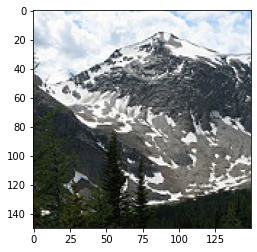

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0009, 'forest': 1e-04, 'glacier': 0.5876, 'mountain': 0.4068, 'sea': 0.0043, 'street': 0.0003}


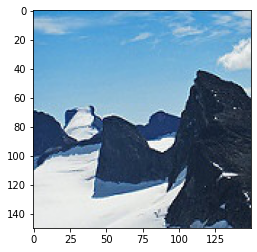

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0012, 'forest': 0.0, 'glacier': 0.9171, 'mountain': 0.0784, 'sea': 0.0028, 'street': 0.0004}


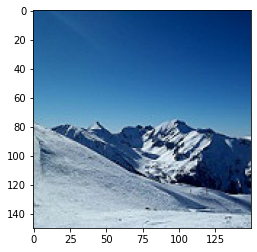

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 1e-04, 'glacier': 0.9641, 'mountain': 0.0219, 'sea': 0.0131, 'street': 0.0005}


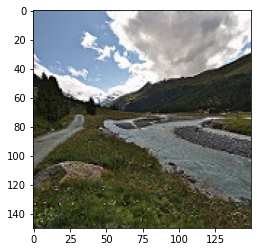

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.002, 'forest': 0.0006, 'glacier': 0.0149, 'mountain': 0.0213, 'sea': 0.96, 'street': 0.0012}


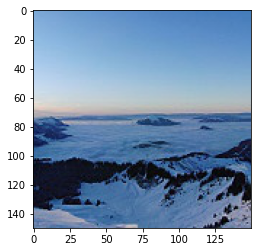

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0013, 'forest': 0.0034, 'glacier': 0.8912, 'mountain': 0.0557, 'sea': 0.0469, 'street': 0.0016}


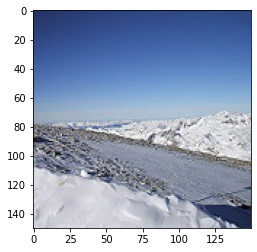

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0193, 'forest': 0.0016, 'glacier': 0.7286, 'mountain': 0.2206, 'sea': 0.0243, 'street': 0.0056}


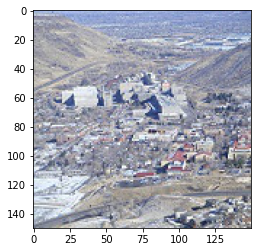

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0011, 'forest': 0.0005, 'glacier': 0.2713, 'mountain': 0.2206, 'sea': 0.4924, 'street': 0.0141}


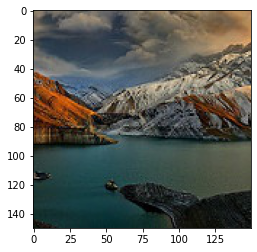

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.004, 'forest': 0.0003, 'glacier': 0.1147, 'mountain': 0.1962, 'sea': 0.6645, 'street': 0.0203}


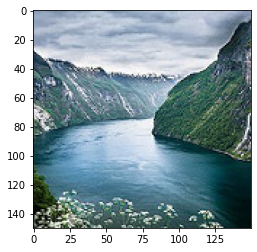

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0, 'glacier': 0.5775, 'mountain': 0.3896, 'sea': 0.0318, 'street': 0.0009}


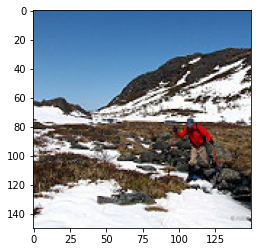

True label is: 'mountain', CNN predicted 'buildings' with confidences {'buildings': 0.8666, 'forest': 0.0012, 'glacier': 0.0417, 'mountain': 0.0746, 'sea': 0.0116, 'street': 0.0042}


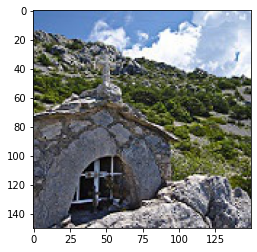

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 1e-04, 'glacier': 0.6665, 'mountain': 0.3043, 'sea': 0.0278, 'street': 0.001}


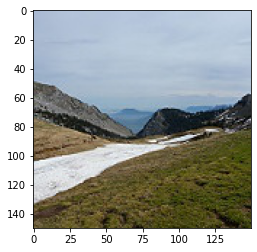

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0029, 'forest': 0.0007, 'glacier': 0.0256, 'mountain': 0.3033, 'sea': 0.6674, 'street': 0.0002}


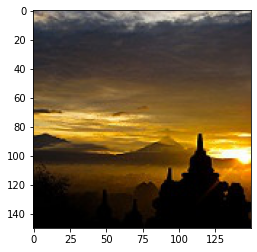

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0012, 'glacier': 0.7014, 'mountain': 0.2503, 'sea': 0.0467, 'street': 0.0002}


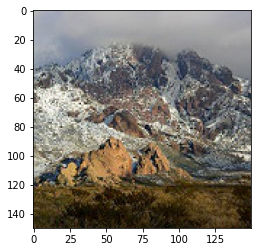

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.001, 'forest': 1e-04, 'glacier': 0.3936, 'mountain': 0.3592, 'sea': 0.2454, 'street': 0.0008}


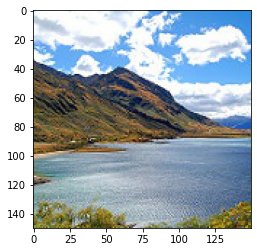

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0006, 'forest': 0.0004, 'glacier': 0.5846, 'mountain': 0.4122, 'sea': 0.0021, 'street': 0.0002}


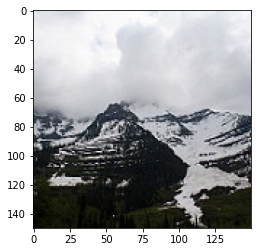

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 1e-04, 'glacier': 0.9618, 'mountain': 0.0372, 'sea': 0.0005, 'street': 0.0002}


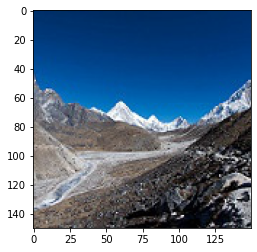

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0009, 'forest': 0.0002, 'glacier': 0.5229, 'mountain': 0.4581, 'sea': 0.0178, 'street': 0.0002}


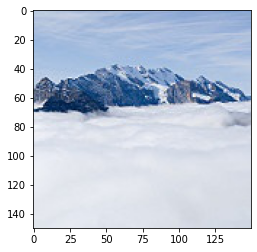

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0012, 'forest': 0.0004, 'glacier': 0.7297, 'mountain': 0.2607, 'sea': 0.0066, 'street': 0.0014}


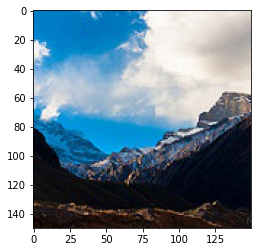

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0006, 'forest': 0.0004, 'glacier': 0.5162, 'mountain': 0.4335, 'sea': 0.0478, 'street': 0.0015}


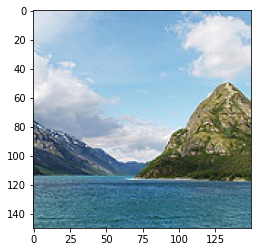

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0008, 'forest': 0.0003, 'glacier': 0.5127, 'mountain': 0.4642, 'sea': 0.0218, 'street': 1e-04}


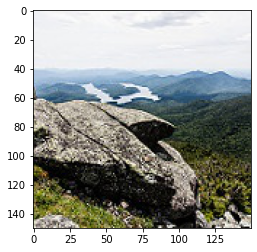

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0096, 'forest': 0.0012, 'glacier': 0.7415, 'mountain': 0.1881, 'sea': 0.0521, 'street': 0.0075}


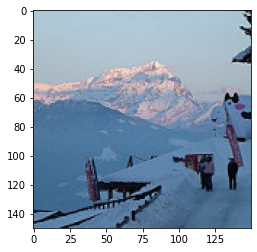

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.5272, 'mountain': 0.4551, 'sea': 0.0158, 'street': 0.0018}


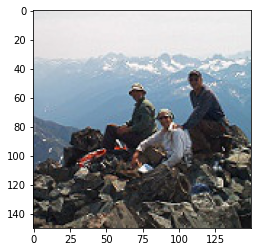

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0013, 'forest': 0.0003, 'glacier': 0.8343, 'mountain': 0.1409, 'sea': 0.0223, 'street': 0.001}


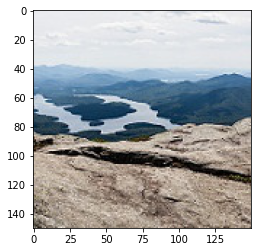

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.5781, 'mountain': 0.4187, 'sea': 0.003, 'street': 1e-04}


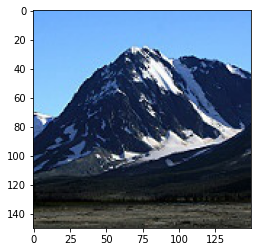

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 1e-04, 'glacier': 0.8899, 'mountain': 0.1064, 'sea': 0.0032, 'street': 1e-04}


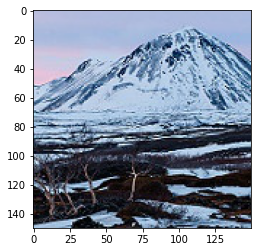

True label is: 'mountain', CNN predicted 'sea' with confidences {'buildings': 0.0011, 'forest': 0.0002, 'glacier': 0.0039, 'mountain': 0.0101, 'sea': 0.9839, 'street': 0.0008}


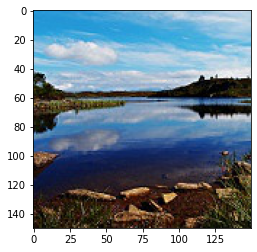

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0267, 'forest': 0.0002, 'glacier': 0.6651, 'mountain': 0.2397, 'sea': 0.0236, 'street': 0.0448}


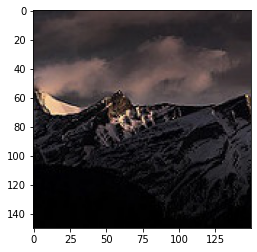

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 0.0, 'glacier': 0.9805, 'mountain': 0.0167, 'sea': 0.0026, 'street': 1e-04}


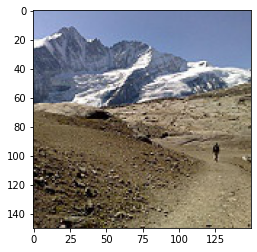

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0024, 'forest': 0.0013, 'glacier': 0.8297, 'mountain': 0.1558, 'sea': 0.0097, 'street': 0.001}


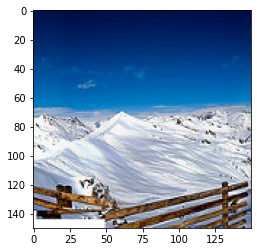

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 1e-04, 'forest': 1e-04, 'glacier': 0.6133, 'mountain': 0.38, 'sea': 0.0062, 'street': 0.0003}


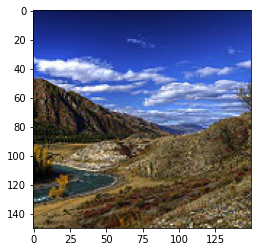

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0039, 'forest': 0.0041, 'glacier': 0.4946, 'mountain': 0.494, 'sea': 0.003, 'street': 0.0005}


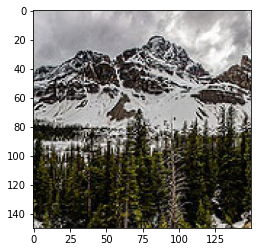

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0, 'forest': 0.0, 'glacier': 0.9711, 'mountain': 0.0284, 'sea': 0.0005, 'street': 0.0}


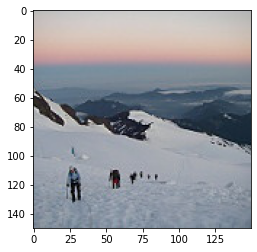

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 0.0, 'glacier': 0.6506, 'mountain': 0.3471, 'sea': 0.0021, 'street': 0.0}


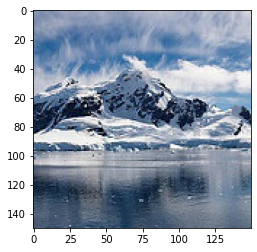

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0003, 'forest': 1e-04, 'glacier': 0.917, 'mountain': 0.0758, 'sea': 0.0058, 'street': 0.0011}


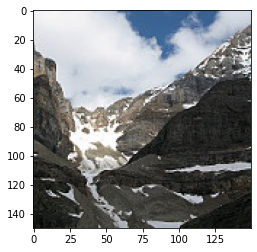

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0002, 'glacier': 0.8675, 'mountain': 0.125, 'sea': 0.0063, 'street': 0.0007}


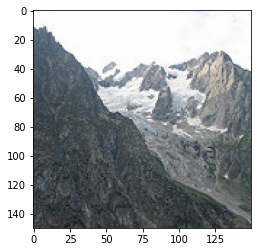

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0004, 'forest': 0.0006, 'glacier': 0.6302, 'mountain': 0.3675, 'sea': 0.0012, 'street': 1e-04}


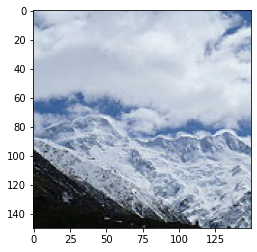

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.003, 'forest': 0.0111, 'glacier': 0.8408, 'mountain': 0.1262, 'sea': 0.0185, 'street': 0.0004}


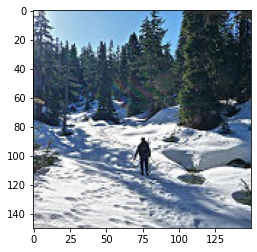

True label is: 'mountain', CNN predicted 'glacier' with confidences {'buildings': 0.0064, 'forest': 0.0014, 'glacier': 0.8322, 'mountain': 0.0806, 'sea': 0.0566, 'street': 0.0228}


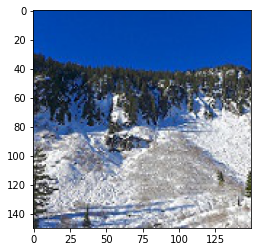

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.0012, 'forest': 0.0016, 'glacier': 0.0195, 'mountain': 0.8983, 'sea': 0.079, 'street': 0.0004}


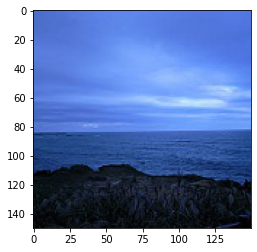

True label is: 'sea', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 1e-04, 'glacier': 0.707, 'mountain': 0.0455, 'sea': 0.2467, 'street': 0.0005}


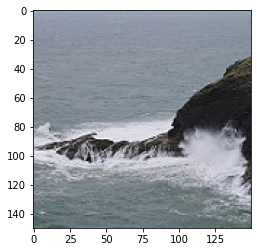

True label is: 'sea', CNN predicted 'glacier' with confidences {'buildings': 0.018, 'forest': 0.0011, 'glacier': 0.4249, 'mountain': 0.1444, 'sea': 0.409, 'street': 0.0025}


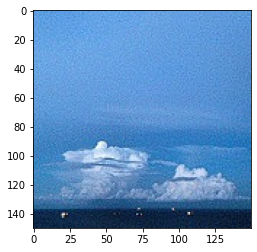

True label is: 'sea', CNN predicted 'glacier' with confidences {'buildings': 0.0002, 'forest': 0.0003, 'glacier': 0.8377, 'mountain': 0.1422, 'sea': 0.0182, 'street': 0.0014}


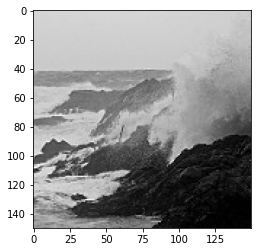

True label is: 'sea', CNN predicted 'buildings' with confidences {'buildings': 0.6032, 'forest': 0.0109, 'glacier': 0.0063, 'mountain': 0.0024, 'sea': 0.3743, 'street': 0.003}


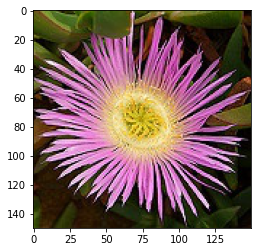

True label is: 'sea', CNN predicted 'glacier' with confidences {'buildings': 0.0184, 'forest': 0.1361, 'glacier': 0.3318, 'mountain': 0.0426, 'sea': 0.2155, 'street': 0.2558}


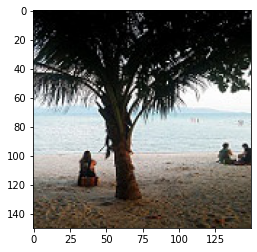

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.0041, 'forest': 0.0068, 'glacier': 0.0855, 'mountain': 0.8655, 'sea': 0.0349, 'street': 0.0032}


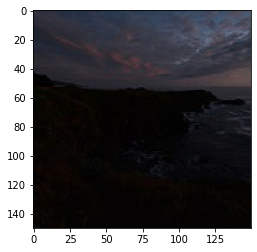

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.0005, 'forest': 0.0018, 'glacier': 0.0835, 'mountain': 0.8726, 'sea': 0.0375, 'street': 0.0041}


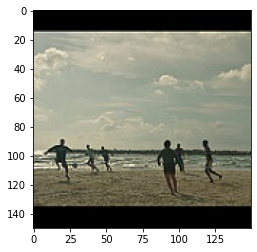

True label is: 'sea', CNN predicted 'forest' with confidences {'buildings': 0.011, 'forest': 0.6241, 'glacier': 0.1975, 'mountain': 0.0088, 'sea': 0.1254, 'street': 0.0333}


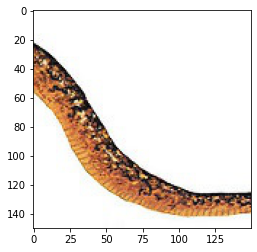

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.0091, 'forest': 0.0049, 'glacier': 0.03, 'mountain': 0.6704, 'sea': 0.2771, 'street': 0.0085}


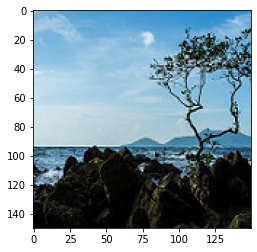

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.008, 'forest': 0.0051, 'glacier': 0.0125, 'mountain': 0.6903, 'sea': 0.2829, 'street': 0.0012}


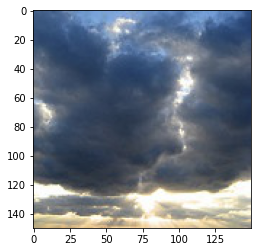

True label is: 'sea', CNN predicted 'buildings' with confidences {'buildings': 0.7756, 'forest': 0.0027, 'glacier': 0.0028, 'mountain': 0.0099, 'sea': 0.1901, 'street': 0.019}


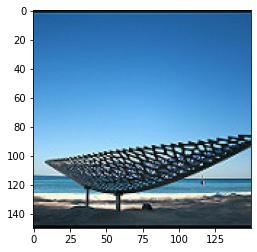

True label is: 'sea', CNN predicted 'forest' with confidences {'buildings': 0.0014, 'forest': 0.4492, 'glacier': 0.1282, 'mountain': 0.0078, 'sea': 0.4131, 'street': 0.0003}


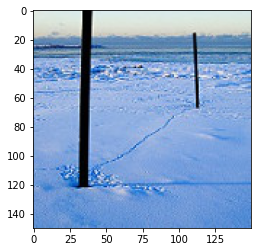

True label is: 'sea', CNN predicted 'glacier' with confidences {'buildings': 0.0289, 'forest': 0.0126, 'glacier': 0.6151, 'mountain': 0.0076, 'sea': 0.3309, 'street': 0.0049}


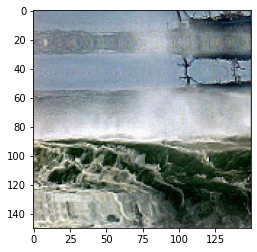

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.02, 'forest': 0.0317, 'glacier': 0.0475, 'mountain': 0.7742, 'sea': 0.119, 'street': 0.0077}


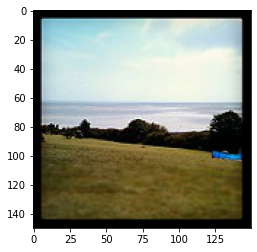

True label is: 'sea', CNN predicted 'mountain' with confidences {'buildings': 0.0077, 'forest': 0.0142, 'glacier': 0.0213, 'mountain': 0.5102, 'sea': 0.4453, 'street': 0.0014}


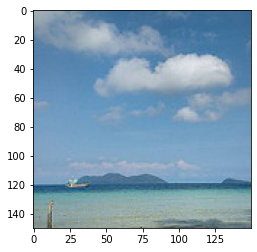

True label is: 'sea', CNN predicted 'forest' with confidences {'buildings': 0.0437, 'forest': 0.5213, 'glacier': 0.0229, 'mountain': 0.0047, 'sea': 0.395, 'street': 0.0123}


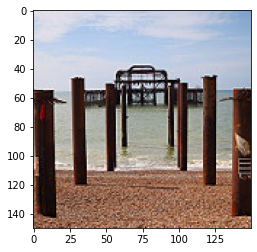

True label is: 'sea', CNN predicted 'buildings' with confidences {'buildings': 0.4122, 'forest': 0.0601, 'glacier': 0.0317, 'mountain': 0.1259, 'sea': 0.354, 'street': 0.0159}


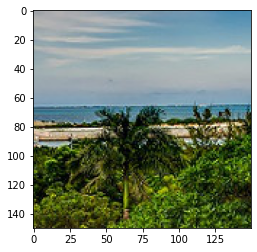

True label is: 'sea', CNN predicted 'buildings' with confidences {'buildings': 0.5053, 'forest': 0.0, 'glacier': 0.0008, 'mountain': 0.0018, 'sea': 0.4919, 'street': 1e-04}


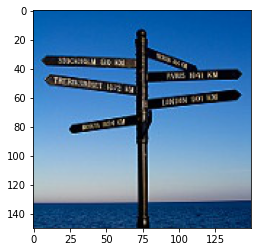

In [ ]:
test_generator.batch_size=3000

img_data= {value:key for key, value in train_generator.class_indices.items()}
misclassifiedClasses = [0, 2, 3, 4]
index = 0
actual_label=test_generator.classes
missclassified_image=None

while missclassified_image is None: 
  x,y=test_generator.next()
  #display the missclassified image together with their predicted probabilities
  for i in np.where(pred_labels != actual_label)[0]:
    if actual_label[i] in misclassifiedClasses:
      print("True label is: '{}', CNN predicted '{}' with confidences {}".
        format(img_data[actual_label[i]],
              img_data[pred_labels[i]],
              dict(zip(img_data.values(),(np.round(predictions[i],4))))))
      plt.imshow(x[i])
      plt.show()
      missclassified_image=x[i]
        


## 7.Research on the web on the Intel image classification problem for look atdifferent architectures other people used to solve this problem. Article/website cited below

I would like to mention that our model which is built on DenseNet121 framework posess test accuracy of 0.953000009059906 after transfer learning. It is equivalent to the first ensemble solution  of Intel Scene Classification Challenge winner and hence appreciable for a beginner.

I have observed that many people who worked on Intel image classification problem used fastai.It is a deep learning library that provides inbuilt methods to calculate best hyperparameters such as learning rate and decent weight which inturn enhances the accuracy and performance of the model.

Let me take example of solution that won Intel Scene Classification Challenge:
https://towardsdatascience.com/1st-place-solution-for-intel-scene-classification-challenge-c95cf941f8ed

1.   This model is built on resnet50 architecture from fastAI library and also PyTorch frameworks along with transfer learning with Progressive Image Resizing. 
2.   Test Time Augmentation and kNN of embeddings or feature vector representation of images which is output of last layer of our model before softmax was also implemented in predicting the class which did not significantly improve the model.   
3. Data is preprocessed with Image Transformations, Normalization, Train Validation Split and interestingly removal of few images  with wrong predictions having confidence less than 0.55 as well as more than 0.999999. This yielded the model test accuracy of 0.964840182648402.
4. Removing confusing data(outliers) may affect the prediction as outliers will have information that has to be considered.
5. One more thing to be noted is utilization of FastAI libraries relies on pytorch, which doesn’t have such mature production (mobile or high scalability server) capabilities compared to tensorflow. This might not allow organizations to consider it for implementation in real time.

Another reference: https://www.kdnuggets.com/2019/05/boost-your-image-classification-model.html